In [ ]:
import os
import pandas as pd
from glob import glob

input_dir = 'clusters20240317'
output_dir = 'clusters20240317-annotated'
os.makedirs(output_dir, exist_ok=True)

for file_path in glob(os.path.join(input_dir, '*.csv')):
    df = pd.read_csv(file_path)
    def reannotate(row):
        if row['claster'] in ['Tc', 'T others', 'Treg', 'TH']:
            cd8 = row['CD8A']
            cd4 = row['CD4']
            fxop3 = row['FXOP3']
            if cd8 > 0 and cd4 > 0:
                return 'Tdp'
            elif cd8 > 0 and cd4 == 0:
                return 'Tc'
            elif cd8 == 0 and cd4 == 0:
                return 'T_others'
            elif cd8 == 0 and cd4 > 0:
                return 'Treg' if fxop3 > 0 else 'TH'
            else:
                return 'T others'
        else:
            return row['claster']
    
    df['claster'] = df.apply(reannotate, axis=1)
    output_path = os.path.join(output_dir, os.path.basename(file_path))
    df.to_csv(output_path, index=False)


In [11]:
import glob
import pandas as pd

for filepath in glob.glob("clusters20250703-annotated/*.csv"):
    df = pd.read_csv(filepath)
    df = df[df['cell'] != '(nan, nan)']
    counts = df['claster'].value_counts().sort_index()    
    print(f"File: {filepath}")
    print(counts)
    print("-" * 40)

File: clusters20250703-annotated/C6-2.csv
AM             197
AT1             49
AT2             75
B_cell          63
Dendritic       33
Endothelial     94
Mac            313
Monocyte       127
NK_cell         11
Neutrophil      36
TH              70
T_others       148
Tc              22
Tdp             11
Treg             4
Undefined      484
Name: claster, dtype: int64
----------------------------------------
File: clusters20250703-annotated/A2-3.csv
AM             209
AT1             50
AT2            100
B_cell          23
Dendritic      104
Endothelial     75
Mac            255
Monocyte        82
NK_cell         16
Neutrophil       7
TH               6
T_others       117
Tc              77
Tdp             12
Undefined      200
Name: claster, dtype: int64
----------------------------------------
File: clusters20250703-annotated/A2-2.csv
AM             166
AT1             51
AT2             81
B_cell          22
Dendritic       97
Endothelial     81
Mac            270
Monocyte      

In [1]:
import numpy as np
import pandas as pd
from aicsimageio import imread
import matplotlib.pyplot as plt
from skimage.measure import regionprops, label
from skimage.segmentation import flood, flood_fill
from skimage.color import label2rgb
from skimage.morphology import erosion
from skimage.morphology import square, octagon
import scipy.ndimage as ndi

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [11]:
def get_new_mask(mask, df):
    ccs = regionprops(mask)
    val2cc = {}
    for cc in ccs:
        c_ = list(cc.centroid)
        val = mask[int(c_[0]), int(c_[1])]
        val2cc[val] = cc
    new_mask = np.zeros(mask.shape, dtype=mask.dtype)
    for _, row in df.iterrows():
        tp = row['claster']
        tp_idx = cell_types.index(tp) + 1
        c_ = [int(float(i)) for i in row['cell'].strip("()").split(",")]
        val = mask[c_[0], c_[1]]
        if val > 0:
            cc = val2cc[val]
            new_mask[cc.coords[:, 0], cc.coords[:, 1]] = tp_idx
        else:
            print(val)
    return new_mask 

def hex_to_array(h):
    h = h.lstrip("#")
    l = [int(h[i:i+2], 16)/255 for i in (0, 2, 4)]
    return np.array(l)

def get_border(mask):
    border = mask - erosion(mask, octagon(3, 1))
    #border = mask - erosion(mask)
    border = border > 0
    return border

def draw_type_mask(ax, mask, colors, labels, bg_color="#000000", back=None, border=None):
    colors_ = [hex_to_array(i) for i in colors]
    bg_color = hex_to_array(bg_color)
    rgb_img = label2rgb(mask, colors=colors_, bg_color=bg_color)
    if border is not None:
        rgb_img[border] = bg_color
    if back is not None:
        back_ratio = 0.4
        back_ = (back ^ back.min()) / (back.max() ^ back.min())
        back_ = np.stack([back_, back_, back_], axis=2)
        img = back_ * 0.8 + rgb_img * 0.8
        ax.imshow(img)
        ax.imshow(back, cmap="gray", alpha=0.5)
        ax.imshow(rgb_img, alpha=0.75)
    else:
        ax.imshow(rgb_img)
    ax.grid(False)
    # Add legend
    patches = [plt.Rectangle((0,0),1,1,fc=color) for color in colors]
    ax.legend(patches, labels, loc=2, bbox_to_anchor=(1.05,1.0),borderaxespad = 0.)
    # ax.axis('off')  # Do not display x and y axes
    ax.grid(False)
    plt.savefig(output_path, format='pdf')
    plt.show()

In [14]:
from matplotlib.patches import Patch

def draw_type_mask(ax, mask, colors, labels, bg_color="#000000", back=None, border=None):
    colors_ = [hex_to_array(h) for h in colors]
    bg_color = hex_to_array(bg_color)
    rgb_img = label2rgb(mask, colors=colors_, bg_color=bg_color)
    ax.imshow(rgb_img)
    # 只为 mask 中实际出现的 cell type 生成图例
    unique_ids = set(np.unique(mask))  # mask 中的值：1,2,3...
    patches = []
    for idx, label in enumerate(labels, start=1):
        if idx in unique_ids:
            patches.append(Patch(color=hex_to_array(colors[idx-1]), label=label))
    ax.legend(handles=patches, loc=2, bbox_to_anchor=(1.05,1.0), borderaxespad=0.)
    ax.grid(False)
    plt.savefig(output_path, format='pdf')
    plt.show()


C3-1
C3 1
(1975, 1944)
0
0
0
0


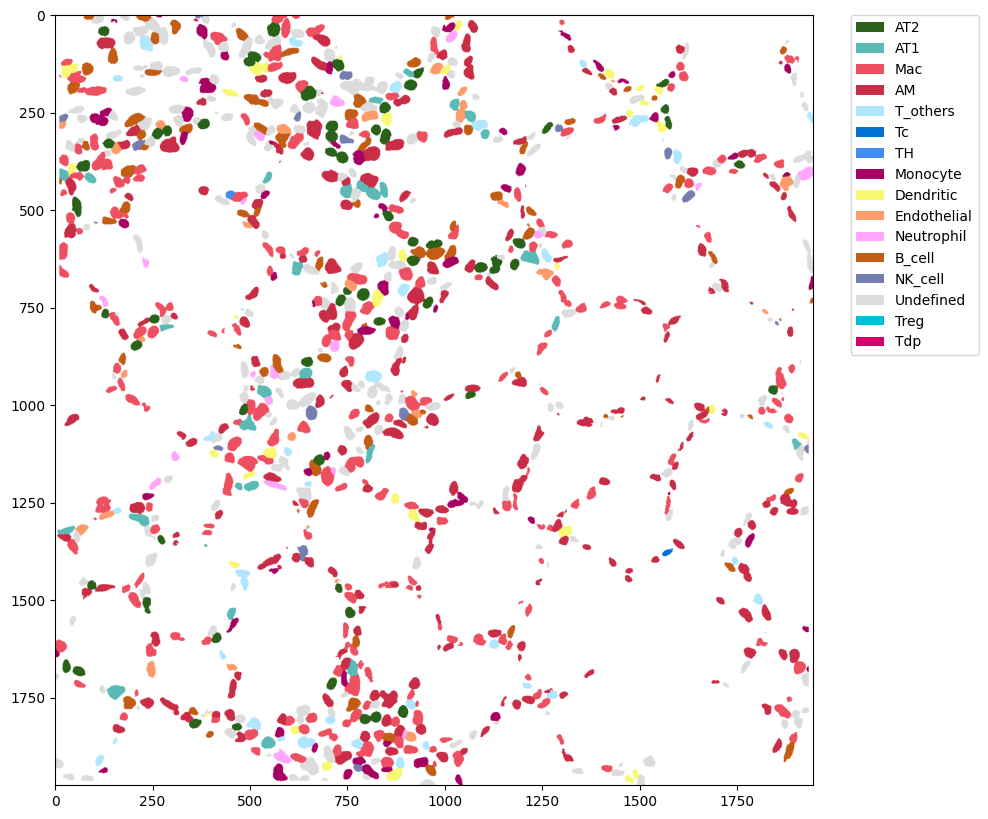

C4-3
C4 3
(1919, 1943)


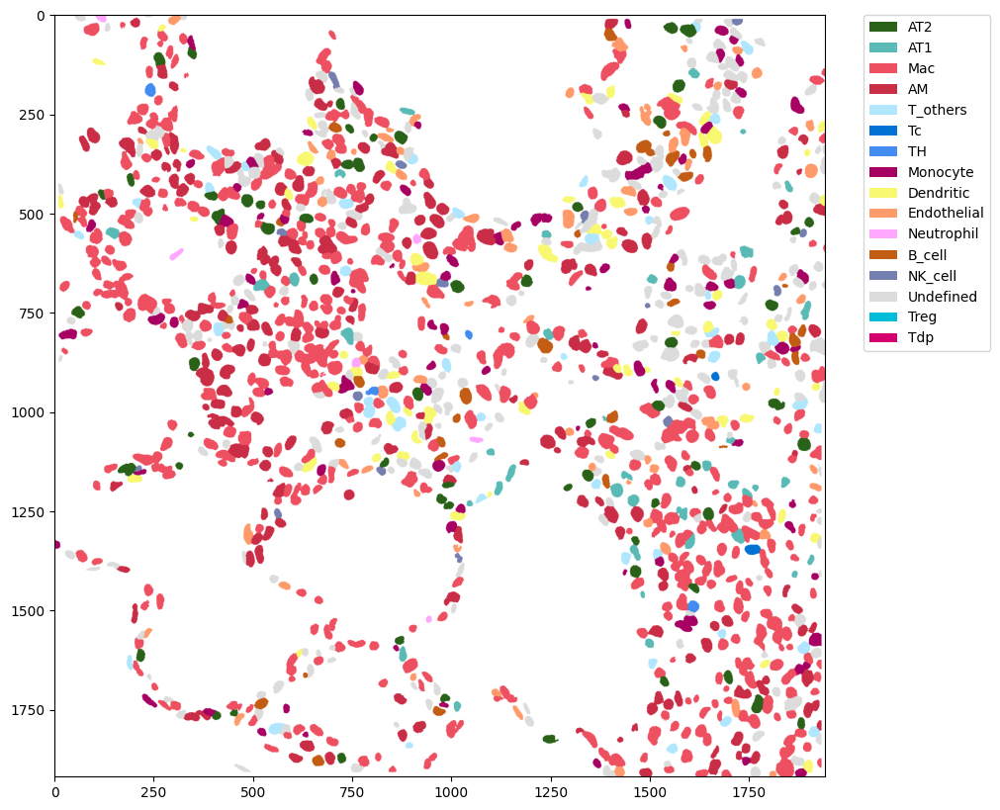

In [25]:
from skimage.io import imread

# samples = [ "A2-1", "A2-2", "A2-3", "A2-4", "A3-1", 
#            "A3-2","A3-3", "A4-1","A4-2", "A4-3", "A5-1",
#             "A5-2", "A5-3",
#             "A6-1", "A6-2", "A6-3", "A6-4", 
#          "C3-1", "C3-2", "C3-3", "C2-1", "C2-2", "C2-3",
#          "C4-1", "C4-2", "C4-3", "C5-1", "C5-2", "C5-3", 
#          "C6-1", "C6-2", "C6-3"]

samples = ["C3-1", "C4-3"]

input_dir = 'clusters20240317-annotated'

cell_types = ['AT2',
 'AT1',
 'Mac',
 'AM',
 'T_others',
 'Tc',
 'TH',
 'Monocyte',
 'Dendritic',
 'Endothelial',
 'Neutrophil',
 'B_cell',
 'NK_cell',
 'Undefined',
 'Treg',
 'Tdp']

colors = ["#296218", "#5ABAB6", "#EE5061", "#CA2D46", 
          "#B0E7FF", "#0072D4", "#428CF2",
          "#A70063", "#F9F871", "#FF9A6B", "#FFA7FF", 
          "#C35D14", "#757FAF", "#DCDCDC", "#00BDD9", "#D5006D"]

type_to_color = dict(zip(cell_types, colors))

for sample in samples:
    print(sample)    
    cell_df = pd.read_csv(f"./{input_dir}/all/{sample}.csv", sep=",")
    cell_df = cell_df[cell_df['cell'] != '(nan, nan)']
    last_row = cell_df.iloc[-1]
    file = sample.split('-')[0]
    id = sample.split('-')[1]
    print(file, id)
    mask = imread(f"./mask/{file}_{id}_mask.tif")
    print(mask.shape)
    # mask = mask[0][0][0][0]
    new_mask = get_new_mask(mask, cell_df)
    fig, (ax1) = plt.subplots(figsize=(20,10))
    m0 = new_mask
    output_path = f'./clusterplot-20250703/{sample}.pdf'
    draw_type_mask(ax1, m0, colors=colors, labels=cell_types, bg_color="#ffffff")

In [10]:
import os 
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import csr_matrix
import matplotlib as mpl
from anndata import AnnData,  read_text
from PIL import Image

import seaborn as sns
import matplotlib.pyplot as plt

import sopa
import sopa.spatial

/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/dask/dataframe/__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(


In [8]:
def load_from_table(
   path :str,
    sample:str,
    z:float=None,
    scale:float=0.2405,
    nuclei_path:str="dapi.tif"
):
    cell = pd.read_csv(path)
    cell.drop(columns=['claster'], inplace=True)
    cell = cell[cell['cell'] != '(nan, nan)']
    try:
        cell = cell.drop('unknow', axis=1)
    except:
        pass
    colnames = cell.columns
    colindex = []
    for i in cell.index:
        colindex.append(sample + "_cell_" + str(i + 1))
    cell["cellid"] = colindex
    cell_by_gene = cell.drop(["cell", "cellid"], axis=1)
    cell_by_gene.index = colindex
    cell_metadata = pd.DataFrame()
    cell_metadata["y"] = cell["cell"].str.split(")").str[0].str.split(",").str[1]
    cell_metadata["x"] = cell["cell"].str.split("(").str[1].str.split(",").str[0]
    cell_metadata.index = colindex
    # adata = read_text("cell_by_gene.csv",delimiter=",", first_column_names=True)
    adata = AnnData(cell_by_gene)
    adata.uns["spatial"] = {"0": {"metadata": {}}}
    blank_genes = np.array(["Blank" in v for v in adata.var_names])
    adata.obsm["blank_genes"] = pd.DataFrame(
        adata[:, blank_genes].X.copy(), columns=adata.var_names[blank_genes], index=adata.obs_names)
    # adata.X = csr_matrix(adata.X)    |
    coords = cell_metadata
    coords.set_index(coords.index.astype("str"), inplace=True)
    adata.obs = pd.merge(adata.obs, coords, how="left", left_index=True, right_index=True)
    adata.obsm["spatial"] = adata.obs[["y", "x"]].values
    adata.uns["spatial"]["0"]["image_key"] = {"hires": np.asarray(Image.open(nuclei_path))}
    if isinstance(z, (int, float)):
        adata.obsm["spatial_3d"] = np.column_stack((adata.obsm["spatial"] * scale, np.full(adata.shape[0], z)))
    return adata

In [12]:
input_dir = 'clusters20250703-annotated/infect'
files = os.listdir(input_dir)
output_path = 'cluster-niche'
os.makedirs(output_path, exist_ok=True)

for file in files:
    path = os.path.join(input_dir, file)
    df = pd.read_csv(path)
    df = df[df['cell'] != '(nan, nan)']
    df['niche'] = ''
    df.loc[df['B646L'] >= 27, 'niche'] = 'High+'
    df.loc[(df['B646L'] < 27) & (df['B646L'] >= 9), 'niche'] = 'High'
    df.loc[(df['B646L'] < 9) & (df['B646L'] >= 1), 'niche'] = 'Semi infected'
    df.loc[df['B646L'] == 0, 'niche'] = 'Bystander cell'
    df.to_csv(os.path.join(output_path, file), index=None)

In [5]:
input_dir = 'clusters20250703-annotated/all'
files = os.listdir(input_dir)

for file in files:
    path = os.path.join(input_dir, file)
    sample = file.split('.')[0]
    slice = sample.split('-')[0]
    id = sample.split('-')[1]
    nuclei_path = f'./mask/{slice}_{id}_mask.tif'
    adata = load_from_table(path = path, sample = sample, nuclei_path = nuclei_path)
    df = pd.read_csv(path)
    df.index = adata.obs_names
    adata.obs['celltype'] = df['claster']
    sopa.spatial.spatial_neighbors(adata, radius=[0, 100])
    cell_type_to_cell_type = sopa.spatial.mean_distance(adata, "celltype", "celltype")
    sopa.spatial.cells_to_groups(adata, "celltype", key_added_prefix="distance_", ignore_zeros =False)
    print(adata.obsm['distance_celltype'])
    adata.obsm['distance_celltype'].to_csv(f'./distance-celltype/{sample}.csv')

[INFO] (sopa.spatial._build) Computing delaunay graph
[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 402.33it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C6-2_cell_1     1.0  5.0  0.0     4.0        1.0          3.0  2.0       1.0   
C6-2_cell_2     1.0  4.0  0.0     2.0        3.0          1.0  1.0       5.0   
C6-2_cell_3     1.0  5.0  0.0     2.0        3.0          2.0  1.0       1.0   
C6-2_cell_4     1.0  4.0  0.0     3.0        3.0          3.0  2.0       2.0   
C6-2_cell_5     1.0  3.0  0.0     5.0        5.0          1.0  1.0       2.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C6-2_cell_1733  1.0  3.0  1.0     4.0        4.0          3.0  1.0       2.0   
C6-2_cell_1734  1.0  4.0  3.0     3.0        4.0          4.0  1.0       1.0   
C6-2_cell_1735  1.0  3.0  3.0     2.0        5.0          2.0  1.0       4.0   
C6-2_cell_1736  1.0  5.0  2.0     2.0        2.0          0.0  1.0       2.0   
C6-2_cell_1737  3.0  4.0  1.0     5.0        7.0          2.0  1.0       1.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 402.18it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A2-3_cell_1     1.0  5.0  0.0     3.0        2.0          3.0  1.0       2.0   
A2-3_cell_2     2.0  1.0  0.0     5.0        2.0          4.0  1.0       1.0   
A2-3_cell_3     3.0  4.0  0.0     1.0        2.0          2.0  1.0       3.0   
A2-3_cell_4     1.0  5.0  0.0     3.0        1.0          3.0  2.0       1.0   
A2-3_cell_5     1.0  4.0  0.0     2.0        1.0          3.0  1.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A2-3_cell_1329  1.0  3.0  2.0     2.0        2.0          2.0  1.0       3.0   
A2-3_cell_1330  1.0  3.0  2.0     6.0        2.0          4.0  1.0       1.0   
A2-3_cell_1331  1.0  3.0  1.0     4.0        1.0          3.0  2.0       1.0   
A2-3_cell_1332  2.0  2.0  3.0     7.0        1.0          5.0  1.0       3.0   
A2-3_cell_1333  1.0  2.0  1.0     2.0        0.0          3.0  2.0       3.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 412.22it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A2-2_cell_1     1.0  2.0  0.0     5.0        5.0          2.0  1.0       2.0   
A2-2_cell_2     1.0  2.0  0.0     6.0        3.0          1.0  1.0       3.0   
A2-2_cell_3     3.0  3.0  0.0     3.0        2.0          1.0  2.0       3.0   
A2-2_cell_4     1.0  6.0  0.0     7.0        2.0          1.0  1.0       3.0   
A2-2_cell_5     1.0  1.0  0.0    10.0        2.0          1.0  2.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A2-2_cell_1338  2.0  2.0  3.0     0.0        3.0          2.0  2.0       5.0   
A2-2_cell_1339  2.0  2.0  2.0     8.0        1.0          2.0  1.0       3.0   
A2-2_cell_1340  3.0  3.0  3.0     4.0        1.0          2.0  1.0       1.0   
A2-2_cell_1341  1.0  2.0  2.0     8.0        1.0          2.0  1.0       3.0   
A2-2_cell_1342  3.0  2.0  2.0     5.0        1.0          0.0  1.0       4.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 417.46it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C4-1_cell_1     1.0  2.0  0.0     2.0        4.0          1.0  2.0       2.0   
C4-1_cell_2     2.0  2.0  0.0     2.0        3.0          2.0  1.0       2.0   
C4-1_cell_3     2.0  4.0  0.0     1.0        3.0          4.0  1.0       2.0   
C4-1_cell_4     1.0  2.0  0.0     3.0        3.0          1.0  2.0       5.0   
C4-1_cell_5     1.0  3.0  0.0     2.0        2.0          1.0  1.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C4-1_cell_1304  1.0  3.0  2.0     4.0        2.0          4.0  1.0       1.0   
C4-1_cell_1305  1.0  3.0  1.0     0.0        3.0          4.0  1.0       1.0   
C4-1_cell_1306  3.0  5.0  2.0     5.0        4.0          2.0  1.0       1.0   
C4-1_cell_1307  2.0  3.0  3.0     1.0        6.0          2.0  2.0       1.0   
C4-1_cell_1308  2.0  3.0  1.0     4.0        2.0          0.0  1.0       1.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 367.40it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C6-3_cell_1     2.0  2.0  0.0     3.0        3.0          1.0  1.0       2.0   
C6-3_cell_2     2.0  1.0  0.0     6.0        1.0          2.0  2.0       1.0   
C6-3_cell_3     1.0  1.0  0.0     2.0        7.0          3.0  1.0       4.0   
C6-3_cell_4     2.0  1.0  0.0     3.0        3.0          1.0  1.0       1.0   
C6-3_cell_5     1.0  2.0  0.0     3.0        4.0          1.0  2.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C6-3_cell_1318  1.0  1.0  2.0     3.0        2.0          2.0  1.0       1.0   
C6-3_cell_1319  1.0  3.0  1.0     4.0        1.0          2.0  2.0       1.0   
C6-3_cell_1320  1.0  4.0  3.0     4.0        4.0          2.0  1.0       2.0   
C6-3_cell_1321  1.0  4.0  2.0     3.0        6.0          5.0  1.0       2.0   
C6-3_cell_1322  1.0  4.0  2.0     3.0        3.0          2.0  1.0       1.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 380.10it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C6-1_cell_1     3.0  8.0  0.0     2.0        3.0          5.0  1.0       1.0   
C6-1_cell_2     2.0  8.0  0.0     4.0        4.0          1.0  1.0       2.0   
C6-1_cell_3     1.0  8.0  0.0     3.0        3.0          1.0  1.0       2.0   
C6-1_cell_4     2.0  2.0  0.0     4.0        2.0          4.0  2.0       4.0   
C6-1_cell_5     3.0  9.0  0.0     2.0        2.0          4.0  1.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C6-1_cell_1379  1.0  3.0  2.0     3.0        3.0          3.0  1.0       2.0   
C6-1_cell_1380  1.0  3.0  2.0     3.0        4.0          3.0  1.0       3.0   
C6-1_cell_1381  2.0  2.0  1.0     6.0        3.0          2.0  1.0       3.0   
C6-1_cell_1382  2.0  1.0  2.0     2.0        2.0          3.0  2.0       1.0   
C6-1_cell_1383  1.0  2.0  2.0     2.0        1.0          4.0  1.0       3.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 14/14 [00:00<00:00, 357.13it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM   AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C4-3_cell_1     2.0   1.0  0.0     2.0        2.0          2.0  1.0       1.0   
C4-3_cell_2     1.0  10.0  0.0     7.0        3.0          6.0  1.0       3.0   
C4-3_cell_3     1.0   3.0  0.0     5.0        3.0          2.0  1.0       4.0   
C4-3_cell_4     1.0   9.0  0.0    10.0        2.0          3.0  1.0       3.0   
C4-3_cell_5     1.0   5.0  0.0     2.0        1.0          2.0  2.0       3.0   
...             ...   ...  ...     ...        ...          ...  ...       ...   
C4-3_cell_1336  1.0   4.0  3.0     1.0        2.0          1.0  1.0       2.0   
C4-3_cell_1337  2.0   5.0  4.0     2.0        2.0          2.0  1.0       2.0   
C4-3_cell_1338  1.0   6.0  2.0     3.0        1.0          1.0  1.0       3.0   
C4-3_cell_1339  3.0   3.0  1.0     3.0        2.0          2.0  1.0       3.0   
C4-3_cell_1340  2.0   6.0  4.0     2.0        2.0          2.0  1.0       3.0   

                NK_cell  Ne

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 398.21it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A6-4_cell_1     2.0  2.0  0.0     1.0        4.0          2.0  2.0       1.0   
A6-4_cell_2     3.0  1.0  0.0     1.0        4.0          3.0  2.0       2.0   
A6-4_cell_3     2.0  2.0  0.0     1.0        3.0          3.0  2.0       1.0   
A6-4_cell_4     3.0  2.0  0.0     2.0        4.0          3.0  1.0       1.0   
A6-4_cell_5     1.0  4.0  0.0     5.0        2.0          5.0  1.0       2.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A6-4_cell_1577  2.0  3.0  1.0     2.0        3.0          2.0  1.0       1.0   
A6-4_cell_1578  1.0  2.0  2.0     5.0        2.0          3.0  1.0       2.0   
A6-4_cell_1579  2.0  3.0  3.0     4.0        1.0          4.0  1.0       3.0   
A6-4_cell_1580  3.0  2.0  3.0     3.0        1.0          1.0  1.0       2.0   
A6-4_cell_1581  4.0  5.0  2.0     1.0        3.0          1.0  2.0       1.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 404.68it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C4-2_cell_1     1.0  5.0  0.0     2.0        2.0          3.0  2.0       2.0   
C4-2_cell_2     2.0  4.0  0.0     1.0        1.0          1.0  2.0       2.0   
C4-2_cell_3     2.0  6.0  0.0     2.0        1.0          3.0  3.0       3.0   
C4-2_cell_4     2.0  3.0  0.0     1.0        1.0          3.0  2.0       2.0   
C4-2_cell_5     1.0  4.0  0.0     3.0        2.0          2.0  2.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C4-2_cell_1602  1.0  5.0  1.0     2.0        3.0          2.0  1.0       3.0   
C4-2_cell_1603  1.0  3.0  3.0     1.0        3.0          2.0  1.0       4.0   
C4-2_cell_1604  1.0  4.0  2.0     2.0       11.0          0.0  2.0       1.0   
C4-2_cell_1605  3.0  3.0  1.0     2.0        3.0          4.0  2.0       2.0   
C4-2_cell_1606  1.0  5.0  3.0     2.0        1.0          2.0  2.0       1.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 407.97it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A2-1_cell_1     1.0  2.0  0.0     5.0        1.0          1.0  1.0       2.0   
A2-1_cell_2     1.0  3.0  0.0     5.0        1.0          2.0  1.0       2.0   
A2-1_cell_3     2.0  3.0  0.0     6.0        3.0          3.0  1.0       2.0   
A2-1_cell_4     1.0  2.0  0.0     4.0        1.0          3.0  1.0       2.0   
A2-1_cell_5     2.0  1.0  0.0     7.0        1.0          1.0  2.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A2-1_cell_1283  2.0  1.0  1.0     9.0        3.0          5.0  1.0       3.0   
A2-1_cell_1284  1.0  4.0  5.0     1.0        3.0          1.0  2.0       1.0   
A2-1_cell_1285  3.0  2.0  1.0     1.0        0.0          2.0  1.0       2.0   
A2-1_cell_1286  2.0  2.0  2.0     1.0        1.0          3.0  1.0       1.0   
A2-1_cell_1287  1.0  1.0  2.0     1.0        2.0          3.0  2.0       1.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 336.06it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A4-3_cell_1     3.0  3.0  0.0     4.0        3.0          2.0  1.0       1.0   
A4-3_cell_2     2.0  2.0  0.0     4.0        5.0          3.0  2.0       1.0   
A4-3_cell_3     2.0  3.0  0.0     2.0        5.0          2.0  1.0       2.0   
A4-3_cell_4     1.0  6.0  0.0     5.0        6.0          5.0  1.0       3.0   
A4-3_cell_5     2.0  1.0  0.0     4.0        5.0          2.0  2.0       2.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A4-3_cell_2085  3.0  4.0  1.0     1.0        2.0          3.0  1.0       3.0   
A4-3_cell_2086  1.0  5.0  4.0     2.0        1.0          4.0  2.0       2.0   
A4-3_cell_2087  4.0  4.0  1.0     4.0        4.0          3.0  1.0       2.0   
A4-3_cell_2088  3.0  4.0  1.0     1.0        4.0          4.0  2.0       1.0   
A4-3_cell_2089  2.0  4.0  1.0     2.0        2.0          2.0  1.0       2.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 356.56it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                  AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A6-1_cell_1      6.0  1.0  0.0     2.0        2.0          1.0  2.0       3.0   
A6-1_cell_2      3.0  4.0  0.0     2.0        1.0          2.0  1.0       1.0   
A6-1_cell_3      3.0  5.0  0.0     1.0        3.0          1.0  2.0       3.0   
A6-1_cell_4      4.0  4.0  0.0     1.0        3.0          2.0  1.0       3.0   
A6-1_cell_5      5.0  4.0  0.0     1.0        2.0          2.0  1.0       1.0   
...              ...  ...  ...     ...        ...          ...  ...       ...   
A6-1_cell_1683   6.0  1.0  1.0     1.0        3.0          0.0  2.0       3.0   
A6-1_cell_1684  10.0  4.0  3.0     2.0        2.0          4.0  1.0       2.0   
A6-1_cell_1685   1.0  6.0  2.0     3.0        2.0          1.0  1.0       2.0   
A6-1_cell_1686   5.0  3.0  3.0     2.0        3.0          2.0  3.0       1.0   
A6-1_cell_1687  10.0  3.0  3.0     0.0        2.0          2.0  1.0       2.0   

                NK_cell  Ne

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 392.30it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A4-2_cell_1     3.0  1.0  0.0     1.0        1.0          4.0  1.0       1.0   
A4-2_cell_2     1.0  2.0  0.0     3.0        3.0          5.0  1.0       4.0   
A4-2_cell_3     1.0  2.0  0.0     3.0        2.0          7.0  1.0       2.0   
A4-2_cell_4     1.0  3.0  0.0     5.0        4.0          8.0  1.0       2.0   
A4-2_cell_5     1.0  2.0  0.0     1.0        6.0          6.0  1.0       2.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A4-2_cell_1799  2.0  3.0  4.0     1.0        3.0          5.0  1.0       3.0   
A4-2_cell_1800  1.0  3.0  2.0     1.0        1.0          4.0  1.0       2.0   
A4-2_cell_1801  1.0  2.0  3.0     3.0        3.0          3.0  1.0       1.0   
A4-2_cell_1802  1.0  1.0  4.0     4.0        2.0          4.0  1.0       3.0   
A4-2_cell_1803  1.0  1.0  5.0     4.0        1.0          4.0  2.0       3.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 369.88it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C2-1_cell_1     2.0  2.0  0.0     4.0        2.0          5.0  2.0       1.0   
C2-1_cell_2     2.0  1.0  0.0     5.0        3.0          4.0  2.0       1.0   
C2-1_cell_3     5.0  3.0  0.0     3.0        1.0          1.0  3.0       4.0   
C2-1_cell_4     1.0  1.0  0.0     3.0        3.0          2.0  1.0       2.0   
C2-1_cell_5     3.0  2.0  0.0     1.0        2.0          1.0  2.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C2-1_cell_1754  2.0  4.0  5.0     1.0        5.0          2.0  3.0       1.0   
C2-1_cell_1755  1.0  1.0  2.0     7.0        2.0          4.0  3.0       2.0   
C2-1_cell_1756  2.0  4.0  3.0     1.0        4.0          2.0  1.0       1.0   
C2-1_cell_1757  1.0  3.0  4.0     4.0        2.0          4.0  1.0       1.0   
C2-1_cell_1758  3.0  2.0  2.0     3.0        3.0          1.0  1.0       2.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 443.50it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A2-4_cell_1     2.0  4.0  0.0     5.0        1.0          1.0  2.0       7.0   
A2-4_cell_2     1.0  3.0  0.0     2.0        3.0          2.0  3.0       5.0   
A2-4_cell_3     2.0  3.0  0.0     2.0        2.0          1.0  1.0       4.0   
A2-4_cell_4     3.0  3.0  0.0     2.0        2.0          1.0  1.0       4.0   
A2-4_cell_5     1.0  2.0  0.0     1.0        1.0          3.0  2.0       2.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A2-4_cell_1224  2.0  2.0  1.0     2.0        1.0          1.0  1.0       3.0   
A2-4_cell_1225  2.0  4.0  1.0     1.0        2.0          1.0  3.0       4.0   
A2-4_cell_1226  1.0  5.0  2.0     3.0        2.0          2.0  2.0       4.0   
A2-4_cell_1227  2.0  3.0  5.0     3.0        1.0          1.0  1.0       4.0   
A2-4_cell_1228  1.0  5.0  3.0     2.0        2.0          1.0  3.0       5.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 403.43it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C2-3_cell_1     1.0  4.0  0.0     2.0        1.0          3.0  2.0       2.0   
C2-3_cell_2     1.0  3.0  0.0     1.0        1.0          2.0  1.0       2.0   
C2-3_cell_3     2.0  3.0  0.0     2.0        1.0          1.0  1.0       1.0   
C2-3_cell_4     1.0  4.0  0.0     2.0        3.0          2.0  1.0       2.0   
C2-3_cell_5     1.0  4.0  0.0     2.0        4.0          2.0  3.0       2.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C2-3_cell_1659  2.0  1.0  2.0     2.0        2.0          1.0  1.0       3.0   
C2-3_cell_1660  2.0  7.0  2.0     3.0        4.0          1.0  1.0       2.0   
C2-3_cell_1661  2.0  3.0  3.0     2.0        6.0          3.0  1.0       1.0   
C2-3_cell_1662  1.0  5.0  4.0     5.0        3.0          2.0  1.0       2.0   
C2-3_cell_1663  2.0  3.0  2.0     1.0        5.0          3.0  1.0       2.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 434.50it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A6-2_cell_1     1.0  4.0  0.0     1.0        1.0          2.0  1.0       2.0   
A6-2_cell_2     3.0  5.0  0.0     6.0        3.0          2.0  1.0       1.0   
A6-2_cell_3     2.0  5.0  0.0     2.0        2.0          2.0  1.0       2.0   
A6-2_cell_4     2.0  2.0  0.0     2.0        1.0          1.0  2.0       1.0   
A6-2_cell_5     1.0  6.0  0.0     3.0        3.0          2.0  2.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A6-2_cell_1303  2.0  6.0  1.0     1.0        4.0          2.0  3.0       3.0   
A6-2_cell_1304  2.0  1.0  2.0     7.0        3.0          2.0  2.0       1.0   
A6-2_cell_1305  1.0  2.0  1.0    11.0        3.0          1.0  2.0       4.0   
A6-2_cell_1306  1.0  7.0  1.0     9.0        3.0          2.0  1.0       2.0   
A6-2_cell_1307  2.0  3.0  2.0     4.0        3.0          4.0  1.0       2.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 399.11it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A6-3_cell_1     2.0  3.0  0.0     3.0        4.0          4.0  1.0       1.0   
A6-3_cell_2     1.0  4.0  0.0     1.0        1.0          4.0  1.0       3.0   
A6-3_cell_3     2.0  2.0  0.0     3.0        2.0          5.0  1.0       3.0   
A6-3_cell_4     1.0  4.0  0.0     3.0        1.0          8.0  2.0       3.0   
A6-3_cell_5     1.0  3.0  0.0     3.0        4.0          2.0  2.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A6-3_cell_1549  1.0  4.0  2.0     1.0        3.0          3.0  1.0       2.0   
A6-3_cell_1550  1.0  4.0  3.0     2.0        2.0          2.0  1.0       4.0   
A6-3_cell_1551  3.0  5.0  4.0     2.0        2.0          5.0  2.0       1.0   
A6-3_cell_1552  3.0  7.0  1.0     5.0        2.0          5.0  1.0       3.0   
A6-3_cell_1553  1.0  7.0  2.0     3.0        2.0          4.0  1.0       1.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 365.61it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C2-2_cell_1     1.0  2.0  0.0     2.0        4.0          2.0  1.0       1.0   
C2-2_cell_2     1.0  2.0  0.0     4.0        4.0          3.0  1.0       1.0   
C2-2_cell_3     1.0  4.0  0.0     5.0        2.0          1.0  2.0       1.0   
C2-2_cell_4     1.0  4.0  0.0     6.0        6.0          3.0  2.0       1.0   
C2-2_cell_5     4.0  2.0  0.0     1.0        6.0          1.0  1.0       3.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C2-2_cell_1412  1.0  3.0  1.0     6.0        3.0          0.0  1.0       2.0   
C2-2_cell_1413  3.0  5.0  4.0     1.0        3.0          3.0  1.0       1.0   
C2-2_cell_1414  1.0  2.0  2.0     3.0        3.0          2.0  1.0       1.0   
C2-2_cell_1415  3.0  2.0  1.0     2.0        5.0          6.0  1.0       1.0   
C2-2_cell_1416  2.0  3.0  3.0     3.0        7.0          4.0  2.0       1.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 376.10it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A4-1_cell_1     2.0  4.0  0.0     2.0        2.0          1.0  1.0       1.0   
A4-1_cell_2     2.0  2.0  0.0     3.0        3.0          1.0  1.0       4.0   
A4-1_cell_3     1.0  2.0  0.0     2.0        3.0          3.0  1.0       4.0   
A4-1_cell_4     1.0  9.0  0.0     2.0        2.0          6.0  2.0       3.0   
A4-1_cell_5     2.0  1.0  0.0     2.0        2.0          1.0  1.0       4.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A4-1_cell_1635  1.0  4.0  4.0     2.0        3.0          5.0  1.0       1.0   
A4-1_cell_1636  1.0  3.0  4.0     1.0        3.0          4.0  1.0       1.0   
A4-1_cell_1637  1.0  3.0  1.0     2.0        4.0          2.0  1.0       3.0   
A4-1_cell_1638  3.0  2.0  1.0     5.0        2.0          4.0  1.0       2.0   
A4-1_cell_1639  2.0  2.0  1.0     3.0        3.0          2.0  1.0       5.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 377.71it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C5-3_cell_1     2.0  1.0  0.0     5.0        2.0          2.0  1.0       2.0   
C5-3_cell_2     2.0  2.0  0.0     8.0        4.0          2.0  1.0       1.0   
C5-3_cell_3     1.0  1.0  0.0     6.0        2.0          4.0  1.0       2.0   
C5-3_cell_4     3.0  2.0  0.0     7.0        3.0          3.0  1.0       2.0   
C5-3_cell_5     1.0  3.0  0.0     6.0        1.0          4.0  2.0       2.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C5-3_cell_1489  1.0  3.0  3.0     6.0        2.0          3.0  1.0       1.0   
C5-3_cell_1490  0.0  1.0  2.0     3.0        4.0          1.0  1.0       3.0   
C5-3_cell_1491  1.0  2.0  4.0     2.0        6.0          1.0  1.0       2.0   
C5-3_cell_1492  2.0  3.0  3.0     2.0        3.0          1.0  4.0       1.0   
C5-3_cell_1493  3.0  4.0  3.0     3.0        2.0          2.0  2.0       1.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 431.60it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C5-2_cell_1     1.0  4.0  0.0     4.0        1.0          2.0  2.0       2.0   
C5-2_cell_2     1.0  2.0  0.0     4.0        2.0          4.0  2.0       4.0   
C5-2_cell_3     3.0  6.0  0.0     3.0        5.0          2.0  1.0       3.0   
C5-2_cell_4     1.0  6.0  0.0     2.0        1.0          6.0  1.0       3.0   
C5-2_cell_5     3.0  2.0  0.0     3.0        3.0          1.0  1.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C5-2_cell_1378  1.0  3.0  2.0     4.0        1.0          4.0  2.0       2.0   
C5-2_cell_1379  3.0  5.0  1.0     4.0        3.0          6.0  1.0       1.0   
C5-2_cell_1380  2.0  6.0  4.0     3.0        2.0          4.0  1.0       2.0   
C5-2_cell_1381  1.0  2.0  1.0     3.0        4.0          2.0  1.0       1.0   
C5-2_cell_1382  1.0  4.0  2.0     2.0        3.0          1.0  1.0       2.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 464.65it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A3-1_cell_1     2.0  1.0  0.0     2.0        5.0          1.0  2.0       2.0   
A3-1_cell_2     2.0  6.0  0.0     3.0        3.0          5.0  1.0       1.0   
A3-1_cell_3     1.0  5.0  0.0     5.0        5.0          2.0  1.0       1.0   
A3-1_cell_4     2.0  2.0  0.0     3.0        1.0          1.0  2.0       1.0   
A3-1_cell_5     4.0  4.0  0.0     2.0        2.0          1.0  1.0       2.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A3-1_cell_1310  2.0  5.0  1.0     2.0        1.0          4.0  1.0       2.0   
A3-1_cell_1311  1.0  1.0  1.0     3.0        5.0          1.0  1.0       1.0   
A3-1_cell_1312  1.0  2.0  2.0     3.0        2.0          2.0  1.0       2.0   
A3-1_cell_1313  1.0  2.0  2.0     4.0        2.0          3.0  1.0       2.0   
A3-1_cell_1314  2.0  4.0  2.0     3.0        3.0          2.0  2.0       1.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 443.25it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A3-3_cell_1     2.0  1.0  0.0     1.0        6.0          3.0  1.0       1.0   
A3-3_cell_2     1.0  1.0  0.0     2.0        4.0          3.0  2.0       1.0   
A3-3_cell_3     1.0  4.0  0.0     2.0        1.0          7.0  1.0       3.0   
A3-3_cell_4     1.0  3.0  0.0     1.0        2.0          3.0  1.0       1.0   
A3-3_cell_5     2.0  2.0  0.0     2.0        2.0          2.0  1.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A3-3_cell_1115  1.0  2.0  2.0     2.0        4.0          1.0  1.0       2.0   
A3-3_cell_1116  1.0  3.0  5.0     4.0        1.0          2.0  1.0       1.0   
A3-3_cell_1117  2.0  3.0  4.0     1.0        3.0          1.0  1.0       2.0   
A3-3_cell_1118  2.0  1.0  1.0     3.0        4.0          4.0  1.0       4.0   
A3-3_cell_1119  1.0  2.0  1.0     2.0        5.0          5.0  1.0       3.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 366.39it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A3-2_cell_1     2.0  2.0  0.0    14.0        3.0          2.0  1.0       1.0   
A3-2_cell_2     2.0  1.0  0.0    15.0        1.0          4.0  1.0       4.0   
A3-2_cell_3     1.0  4.0  0.0    15.0        2.0          1.0  1.0       1.0   
A3-2_cell_4     1.0  3.0  0.0    15.0        1.0          1.0  2.0       4.0   
A3-2_cell_5     3.0  1.0  0.0    14.0        1.0          2.0  1.0       2.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A3-2_cell_1250  1.0  4.0  3.0    16.0        1.0          1.0  1.0       2.0   
A3-2_cell_1251  1.0  4.0  5.0     3.0        4.0          3.0  2.0       3.0   
A3-2_cell_1252  1.0  3.0  4.0     3.0        3.0          2.0  1.0       2.0   
A3-2_cell_1253  1.0  3.0  2.0    16.0        2.0          3.0  1.0       5.0   
A3-2_cell_1254  1.0  3.0  2.0    16.0        2.0          4.0  1.0       3.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 411.96it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C5-1_cell_1     1.0  6.0  0.0     2.0        5.0          3.0  1.0       2.0   
C5-1_cell_2     1.0  6.0  0.0     2.0        6.0          3.0  1.0       1.0   
C5-1_cell_3     2.0  3.0  0.0     6.0        2.0          1.0  2.0       1.0   
C5-1_cell_4     2.0  3.0  0.0     6.0        1.0          1.0  2.0       1.0   
C5-1_cell_5     1.0  4.0  0.0     3.0        3.0          2.0  1.0       3.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C5-1_cell_1408  1.0  4.0  2.0     4.0        5.0          3.0  1.0       2.0   
C5-1_cell_1409  1.0  4.0  2.0     1.0        5.0          1.0  1.0       1.0   
C5-1_cell_1410  2.0  5.0  4.0     5.0        3.0          2.0  1.0       2.0   
C5-1_cell_1411  1.0  4.0  1.0     2.0        4.0          0.0  2.0       2.0   
C5-1_cell_1412  1.0  5.0  1.0     3.0        5.0          0.0  3.0       2.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 399.86it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C3-3_cell_1     1.0  2.0  0.0     3.0        7.0          2.0  1.0       2.0   
C3-3_cell_2     1.0  7.0  0.0     2.0        3.0          3.0  1.0       1.0   
C3-3_cell_3     1.0  2.0  0.0     6.0        8.0          2.0  1.0       3.0   
C3-3_cell_4     1.0  3.0  0.0     5.0        1.0          1.0  1.0       2.0   
C3-3_cell_5     1.0  2.0  0.0     3.0        3.0          4.0  1.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C3-3_cell_1107  2.0  3.0  4.0     3.0        5.0          1.0  1.0       2.0   
C3-3_cell_1108  1.0  2.0  2.0     5.0        4.0          4.0  1.0       2.0   
C3-3_cell_1109  1.0  5.0  4.0     1.0        2.0          2.0  1.0       3.0   
C3-3_cell_1110  2.0  5.0  5.0     1.0        2.0          2.0  1.0       2.0   
C3-3_cell_1111  1.0  5.0  2.0     2.0        1.0          3.0  1.0       1.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 14/14 [00:00<00:00, 419.49it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C3-2_cell_1    2.0  2.0  0.0     3.0        3.0          1.0  2.0       1.0   
C3-2_cell_2    2.0  2.0  0.0     7.0        1.0          3.0  1.0       1.0   
C3-2_cell_3    1.0  4.0  0.0     4.0        5.0          2.0  1.0       2.0   
C3-2_cell_4    1.0  7.0  0.0     7.0        2.0          3.0  1.0       3.0   
C3-2_cell_5    1.0  4.0  0.0     1.0        3.0          3.0  2.0       2.0   
...            ...  ...  ...     ...        ...          ...  ...       ...   
C3-2_cell_974  1.0  8.0  5.0    10.0        4.0          1.0  2.0       3.0   
C3-2_cell_975  2.0  2.0  1.0     5.0        2.0          3.0  1.0       1.0   
C3-2_cell_976  2.0  8.0  2.0    11.0        2.0          1.0  2.0       1.0   
C3-2_cell_977  1.0  2.0  5.0     2.0        3.0          1.0  1.0       9.0   
C3-2_cell_978  2.0  4.0  5.0     6.0        4.0          5.0  1.0       3.0   

               NK_cell  Neutrophil   TH  T_others  

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 465.51it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A5-1_cell_1     1.0  2.0  0.0     3.0        3.0          3.0  1.0       2.0   
A5-1_cell_2     1.0  5.0  0.0     2.0        4.0          1.0  2.0       1.0   
A5-1_cell_3     1.0  3.0  0.0     2.0        2.0          4.0  1.0       3.0   
A5-1_cell_4     1.0  4.0  0.0     2.0        4.0          1.0  1.0       2.0   
A5-1_cell_5     1.0  3.0  0.0     1.0        5.0          5.0  2.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A5-1_cell_1027  2.0  1.0  2.0     2.0        4.0          4.0  1.0       6.0   
A5-1_cell_1028  1.0  6.0  8.0     0.0        2.0          2.0  1.0       1.0   
A5-1_cell_1029  2.0  2.0  1.0     2.0        4.0          4.0  2.0       4.0   
A5-1_cell_1030  1.0  5.0  2.0     4.0        2.0          7.0  1.0       2.0   
A5-1_cell_1031  2.0  6.0  5.0     3.0        3.0          4.0  1.0       2.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 460.32it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A5-3_cell_1     2.0  3.0  0.0     5.0        2.0          1.0  2.0       1.0   
A5-3_cell_2     2.0  3.0  0.0     3.0        2.0          3.0  1.0       4.0   
A5-3_cell_3     2.0  1.0  0.0     5.0        1.0          1.0  1.0       2.0   
A5-3_cell_4     1.0  3.0  0.0     6.0        2.0          1.0  2.0       2.0   
A5-3_cell_5     2.0  3.0  0.0     8.0        1.0          6.0  1.0       3.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A5-3_cell_1223  2.0  1.0  4.0     3.0        2.0          3.0  1.0       2.0   
A5-3_cell_1224  1.0  4.0  3.0     4.0        0.0          3.0  3.0       3.0   
A5-3_cell_1225  3.0  6.0  3.0     4.0        3.0          2.0  2.0       2.0   
A5-3_cell_1226  2.0  1.0  4.0     4.0        1.0          4.0  1.0       2.0   
A5-3_cell_1227  1.0  5.0  1.0     3.0        3.0          3.0  1.0       2.0   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 525.22it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph


                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
A5-2_cell_1     5.0  1.0  0.0     3.0        5.0          2.0  3.0       2.0   
A5-2_cell_2     1.0  1.0  0.0     4.0        4.0          5.0  1.0       2.0   
A5-2_cell_3     2.0  2.0  0.0     2.0        1.0          2.0  1.0       3.0   
A5-2_cell_4     1.0  1.0  0.0     4.0        5.0          5.0  2.0       2.0   
A5-2_cell_5     2.0  4.0  0.0     2.0        3.0          4.0  2.0       6.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
A5-2_cell_1068  4.0  4.0  4.0     2.0        1.0          2.0  1.0       6.0   
A5-2_cell_1069  2.0  1.0  2.0     4.0        1.0          0.0  1.0       2.0   
A5-2_cell_1070  1.0  3.0  3.0     1.0        2.0          5.0  1.0       5.0   
A5-2_cell_1071  1.0  2.0  1.0     2.0        1.0          2.0  2.0       1.0   
A5-2_cell_1072  NaN  NaN  NaN     NaN        NaN          NaN  NaN       NaN   

                NK_cell  Neutrophil   T

[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 14/14 [00:00<00:00, 358.53it/s]

                 AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
C3-1_cell_1     1.0  1.0  0.0     4.0        2.0          3.0  1.0       4.0   
C3-1_cell_2     2.0  6.0  0.0     2.0        1.0          5.0  1.0       2.0   
C3-1_cell_3     2.0  3.0  0.0     1.0        2.0          1.0  1.0       1.0   
C3-1_cell_4     2.0  5.0  0.0     2.0        1.0          5.0  2.0       1.0   
C3-1_cell_5     2.0  3.0  0.0     3.0        1.0          5.0  3.0       1.0   
...             ...  ...  ...     ...        ...          ...  ...       ...   
C3-1_cell_1071  0.0  5.0  5.0     2.0        2.0          9.0  2.0       5.0   
C3-1_cell_1072  1.0  4.0  2.0     1.0        6.0          1.0  0.0       5.0   
C3-1_cell_1073  0.0  2.0  3.0     2.0        5.0          3.0  1.0       3.0   
C3-1_cell_1074  3.0  3.0  1.0     2.0        2.0          5.0  0.0       5.0   
C3-1_cell_1075  2.0  4.0  3.0     1.0        6.0          1.0  0.0       5.0   

                NK_cell  Neutrophil    

[INFO] (sopa.spatial._build) Computing delaunay graph
[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 265.93it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph
[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 363.02it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph
[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 408.57it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph
[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 16/16 [00:00<00:00, 340.51it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph
[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 15/15 [00:00<00:00, 328.10it/s]
[INFO] (sopa.spatial._build) Computing delaunay graph
[INFO] (sopa.spatial.distance) Converting adata.obs

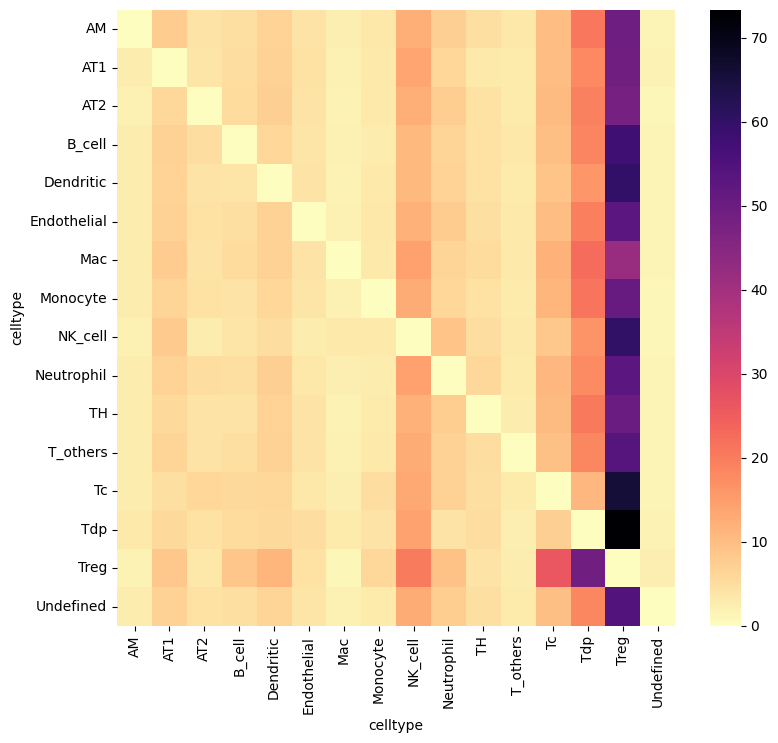

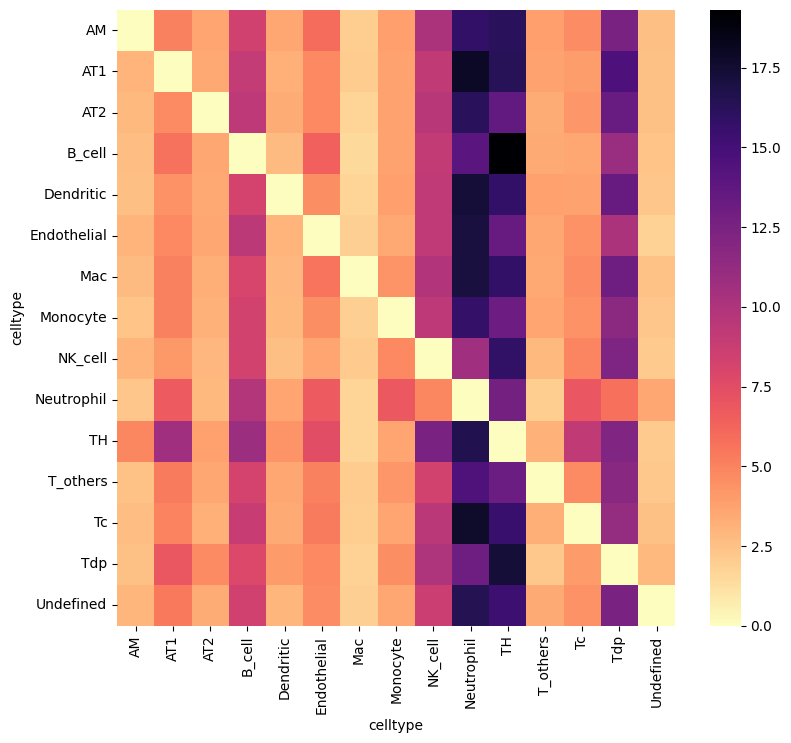

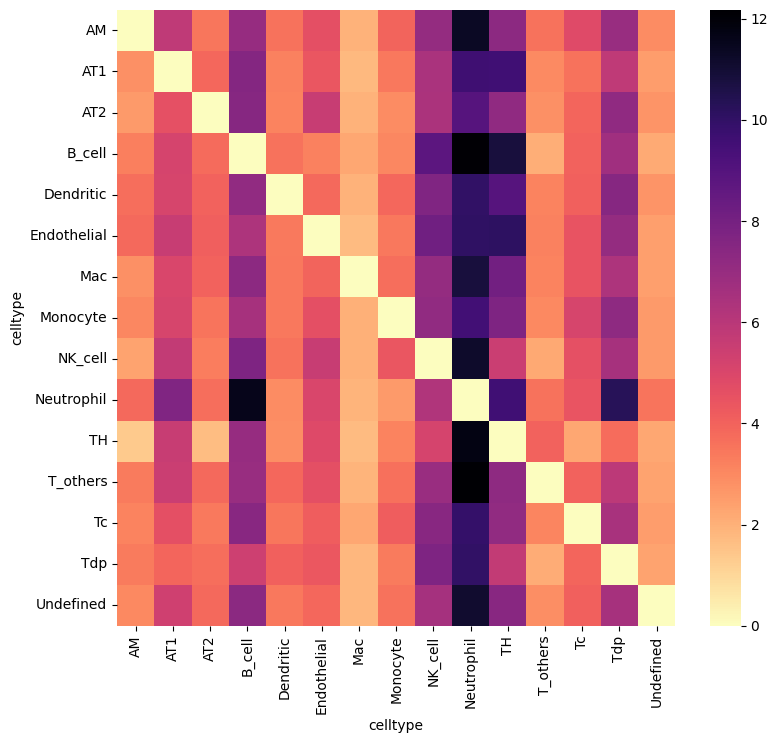

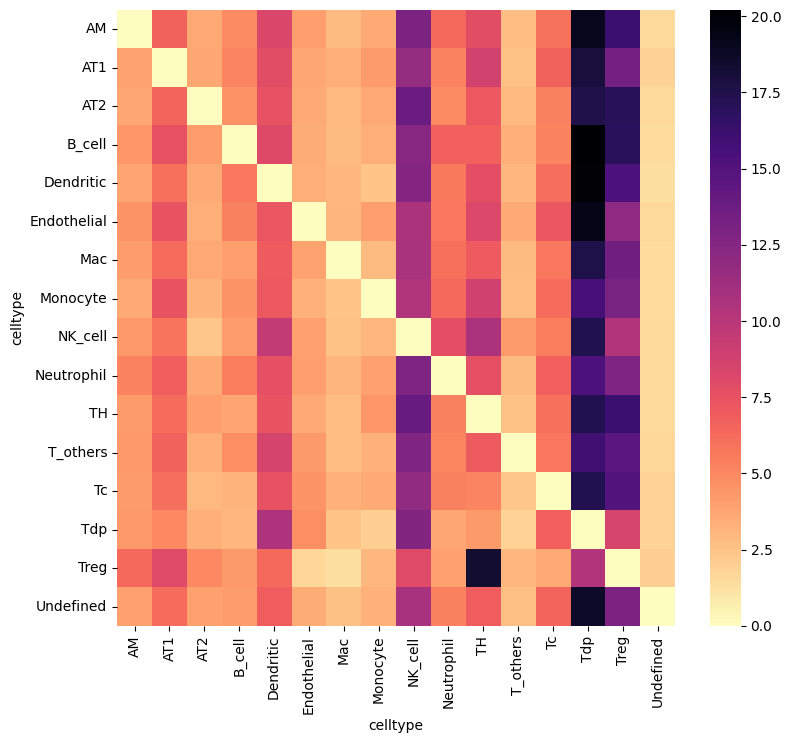

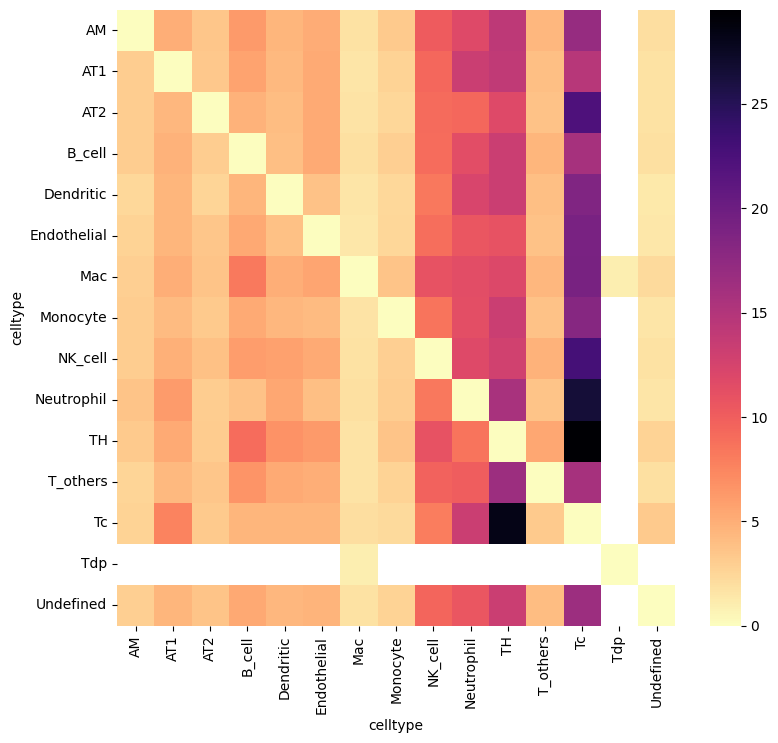

...

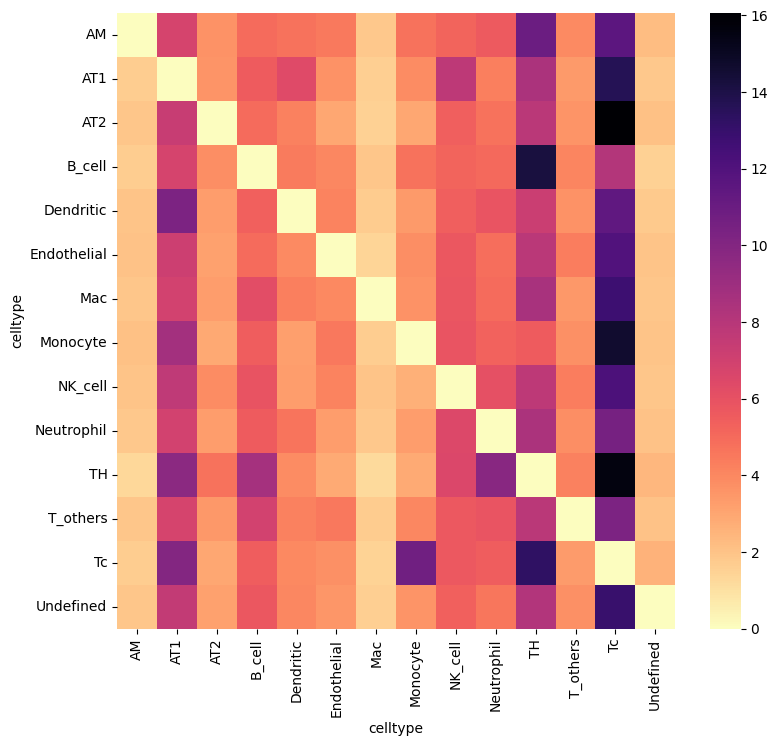

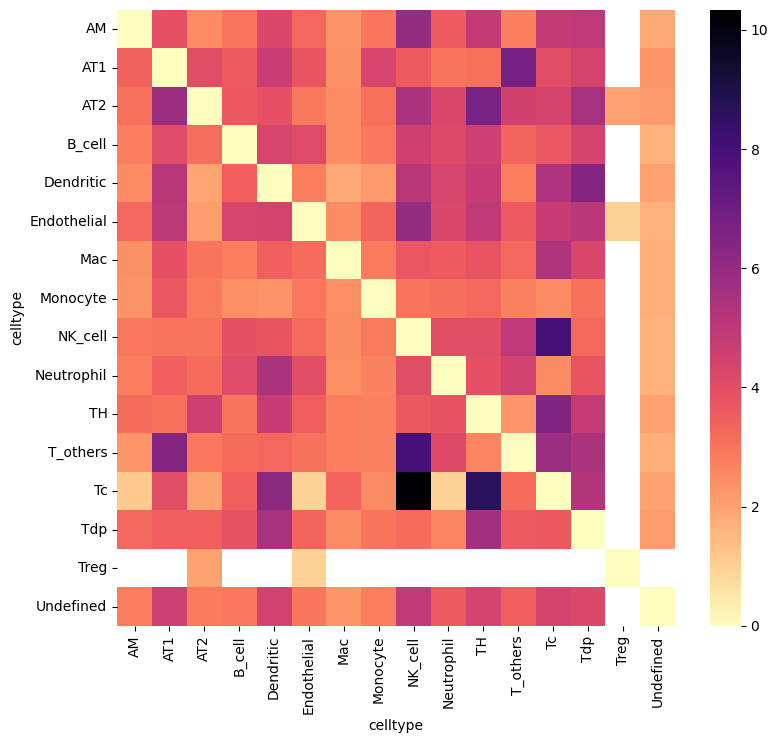

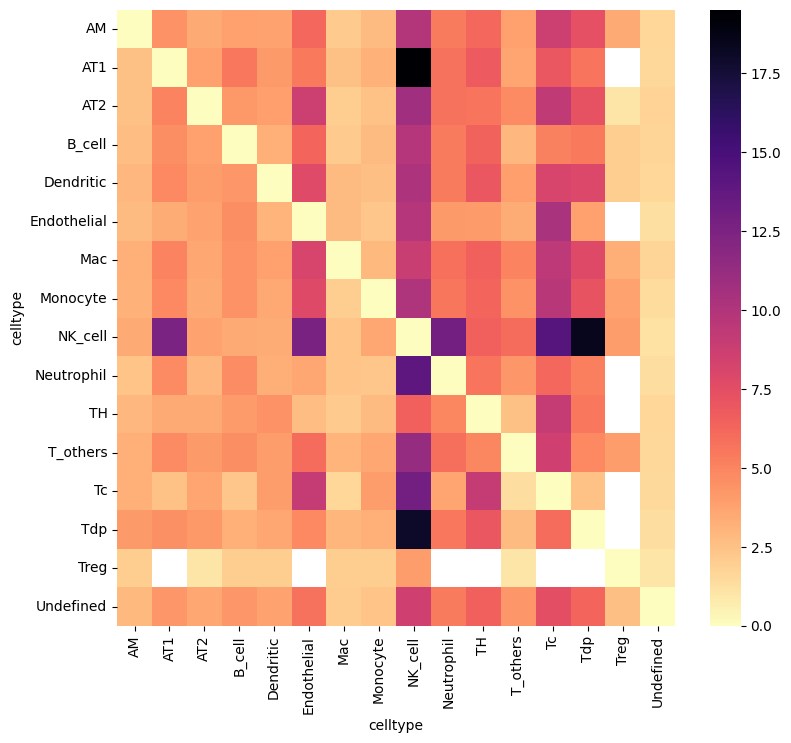

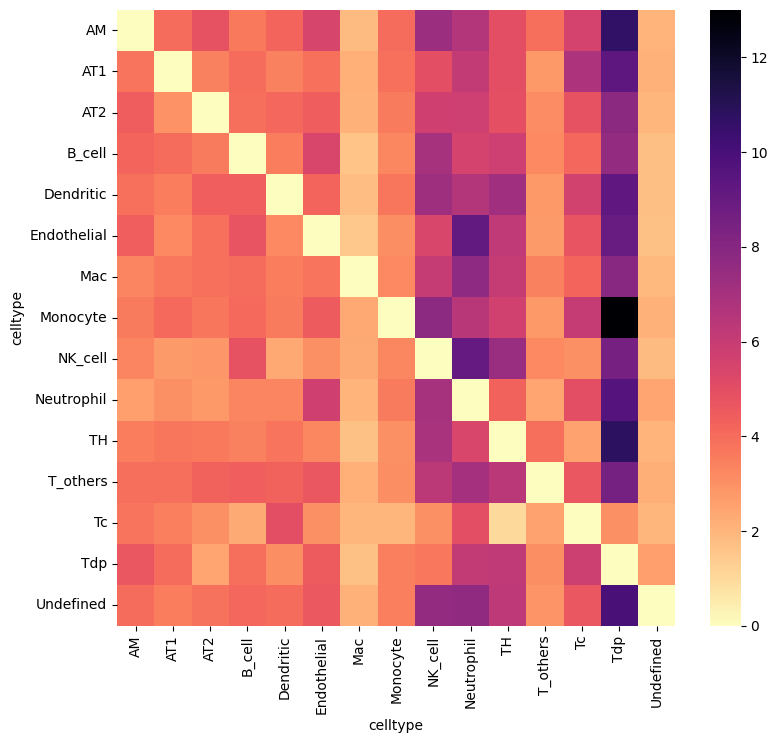

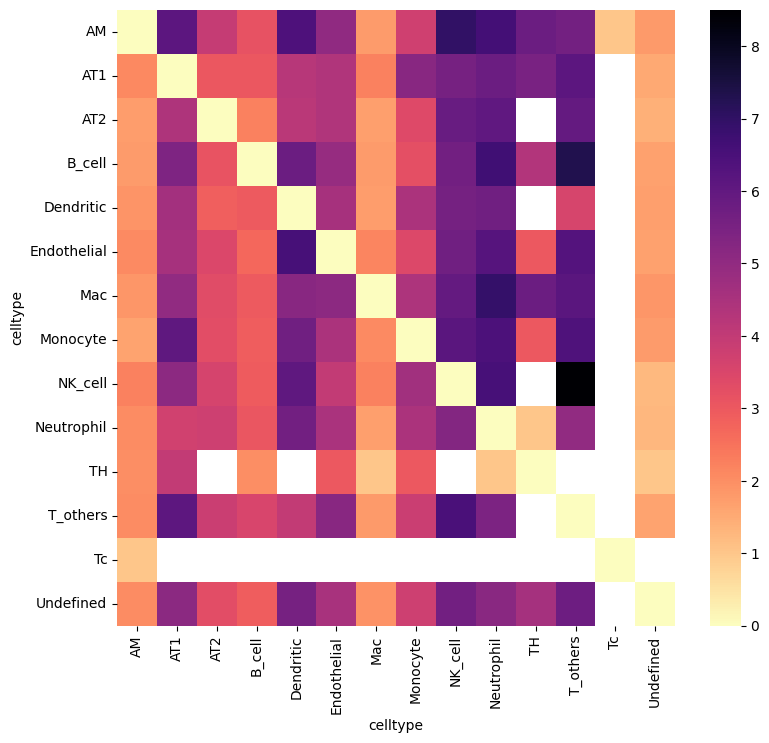

In [7]:
input_dir = 'clusters20250703-annotated/all'
files = os.listdir(input_dir)

for file in files:
    path = os.path.join(input_dir, file)
    sample = file.split('.')[0]
    slice = sample.split('-')[0]
    id = sample.split('-')[1]
    nuclei_path = f'./mask/{slice}_{id}_mask.tif'
    adata = load_from_table(path = path, sample = sample, nuclei_path = nuclei_path)
    df = pd.read_csv(path)
    df.index = adata.obs_names
    adata.obs['celltype'] = df['claster']
    sopa.spatial.spatial_neighbors(adata, radius=[0, 50])
    cell_type_to_cell_type = sopa.spatial.mean_distance(adata, "celltype", "celltype")
    plt.figure(figsize=(9, 8))
    fig = sns.heatmap(cell_type_to_cell_type, cmap= 'magma_r')
    output_path = f'./sopa_results/celltype-inter/{sample}.pdf'
    result = fig.get_figure()
    result.savefig(output_path, format = 'pdf')

In [2]:
import pandas as pd
import numpy as np
import os

directory = 'sopa_results/celltype-niches'
directories = [d for d in os.listdir(directory) if os.path.isdir(os.path.join(directory, d))]

for d in directories:
    interaction_matrices = []
    subdir = os.path.join(directory, d)
    print(f"Contents of directory '{d}':")
    for filename in os.listdir(subdir):
        file_path = os.path.join(subdir, filename)
        df = pd.read_csv(file_path, index_col='celltype')
        interaction_matrices.append(df)

    sum_matrix = pd.DataFrame(0, index=df.index, columns=df.columns)
    for matrix in interaction_matrices:
        sum_matrix += matrix       
    average_matrix = sum_matrix / len(interaction_matrices)
    output_path = f'./sopa_results/celltype-niches/{d}-celltype-niches-merged.csv'
    average_matrix.to_csv(output_path)

Contents of directory 'ea':
Contents of directory 'la':


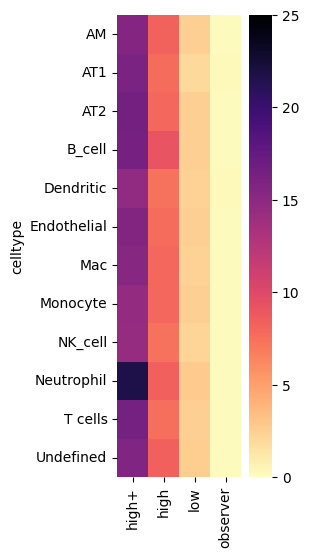

In [37]:
import matplotlib.pyplot as plt
import seaborn as sns

sample = 'ea'
niches_to_niches = pd.read_csv(f'tmp/sopa_results/celltype-niches/celltype-niches/ea-celltype-niches-merged.csv', index_col= 'celltype')
plt.figure(figsize=(2, 6))
fig = sns.heatmap(niches_to_niches, cmap= 'magma_r', vmin=0, vmax=25)
output_path = f'./tmp/sopa_results/celltype-niches/{sample}.pdf'
result = fig.get_figure()
result.savefig(output_path, format = 'pdf')

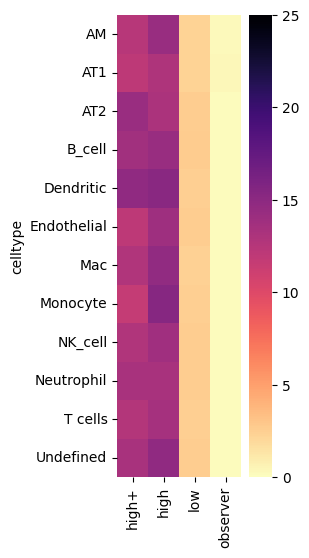

In [36]:
sample = 'la'
niches_to_niches = pd.read_csv(f'tmp/sopa_results/celltype-niches/celltype-niches/{sample}-celltype-niches-merged.csv', index_col= 'celltype')
plt.figure(figsize=(2, 6))
fig = sns.heatmap(niches_to_niches, cmap= 'magma_r', vmin=0, vmax=25)
output_path = f'./tmp/sopa_results/celltype-niches/celltype-niches/{sample}.pdf'
result = fig.get_figure()
result.savefig(output_path, format = 'pdf')

/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A2-3


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 203.25it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A2-2


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 23/23 [00:00<00:00, 177.23it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A6-4


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 162.06it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A2-1


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 23/23 [00:00<00:00, 194.48it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A4-3


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 23/23 [00:00<00:00, 167.87it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A6-1


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 179.08it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A4-2


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 154.90it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A2-4


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 210.41it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A6-2


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 23/23 [00:00<00:00, 176.08it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A6-3


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 23/23 [00:00<00:00, 178.88it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A4-1


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 23/23 [00:00<00:00, 162.32it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A3-1


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 215.20it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A3-3


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 248.86it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A3-2


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 23/23 [00:00<00:00, 254.22it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A5-1


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 421.93it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A5-3


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 294.21it/s]
/Users/caihuaiyuan/opt/anaconda3/envs/sopa/lib/python3.10/site-packages/anndata/utils.py:292: UserWarning: X converted to numpy array with dtype object
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
[INFO] (sopa.spatial._build) Computing delaunay graph


A5-2


[INFO] (sopa.spatial.distance) Converting adata.obs['celltype'] to category
100%|██████████| 24/24 [00:00<00:00, 263.56it/s]


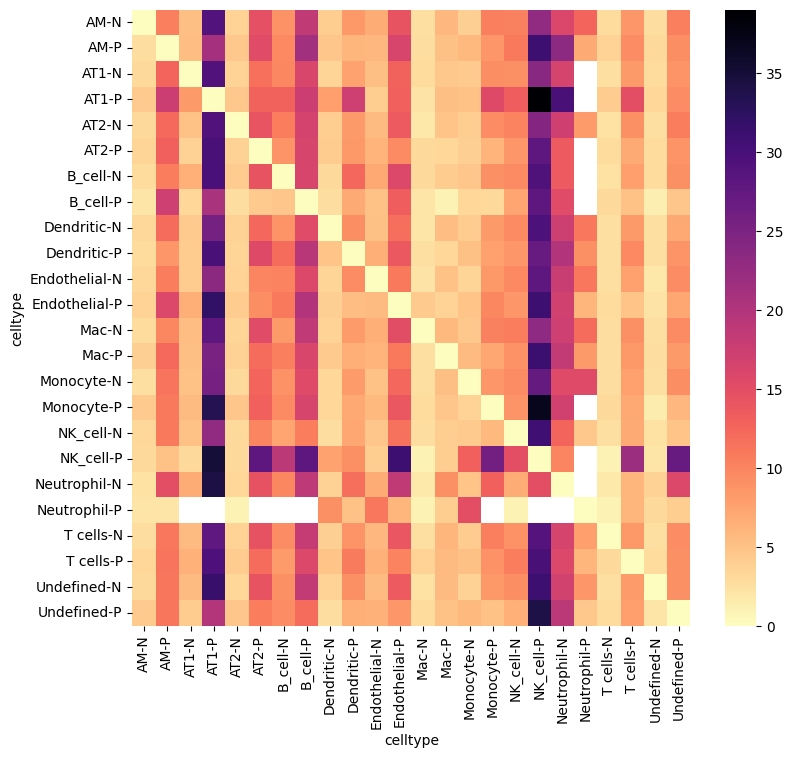

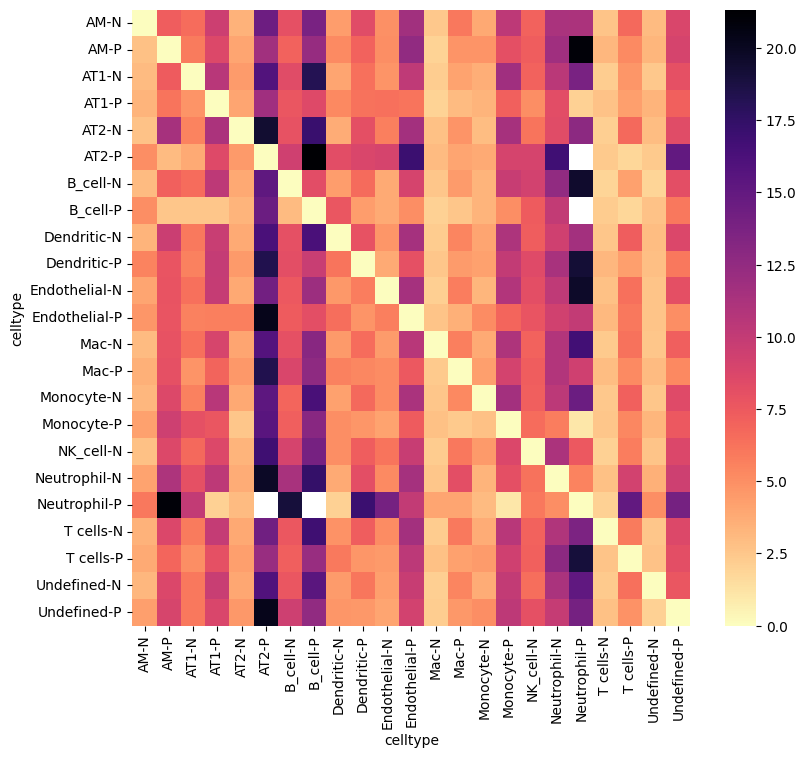

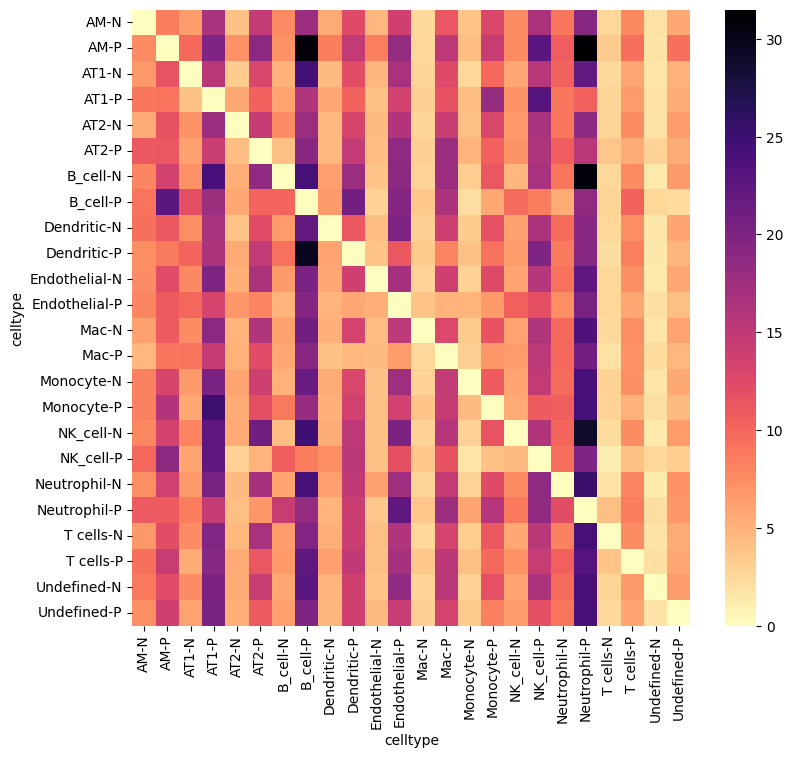

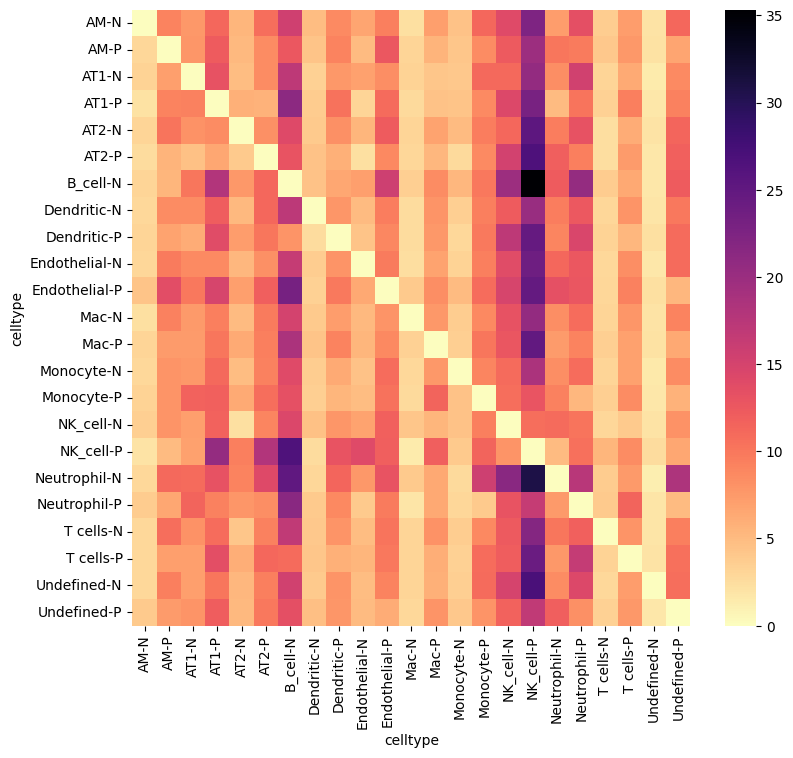

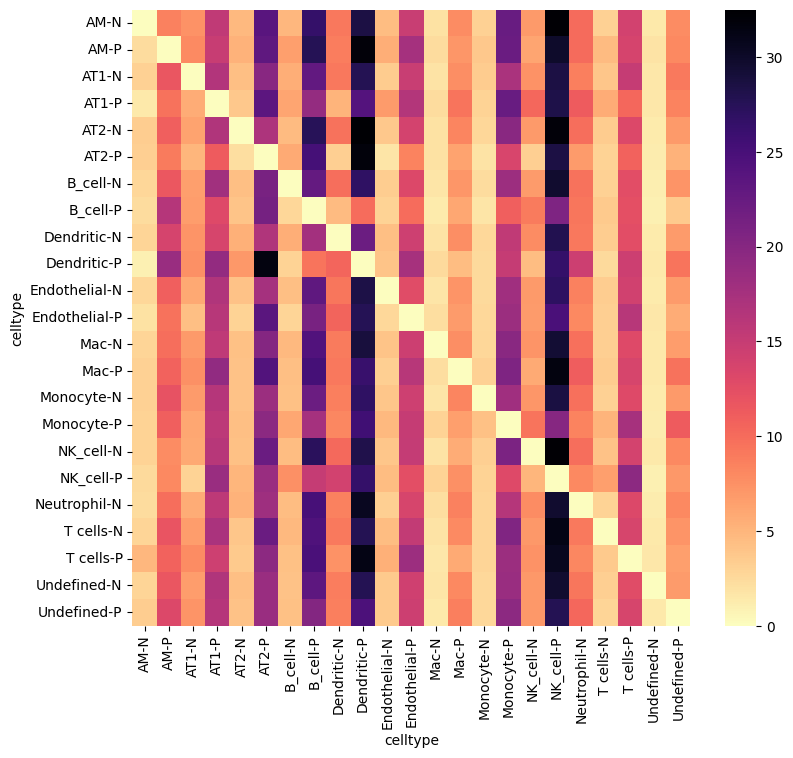

...

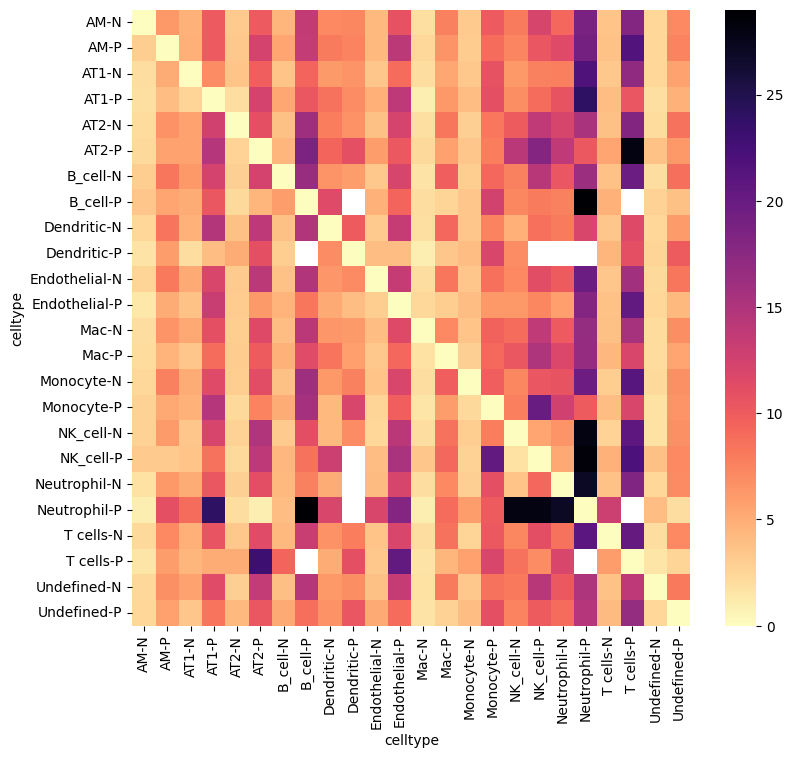

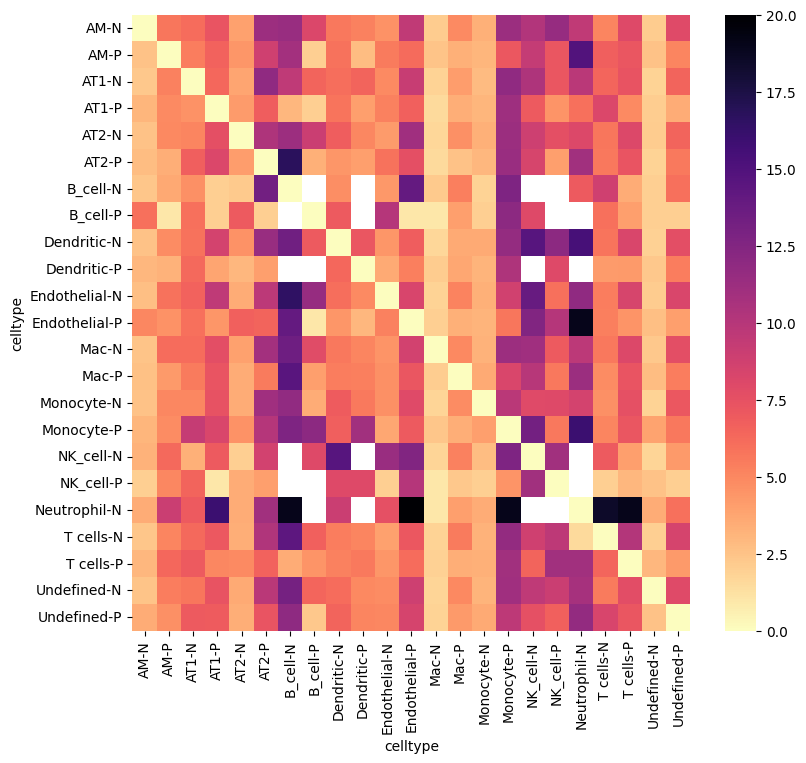

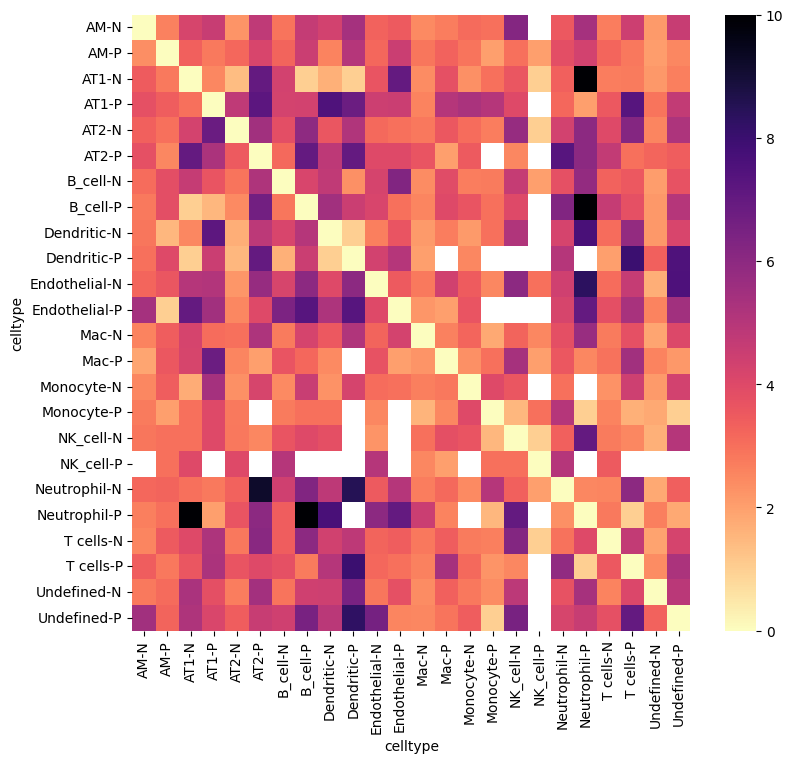

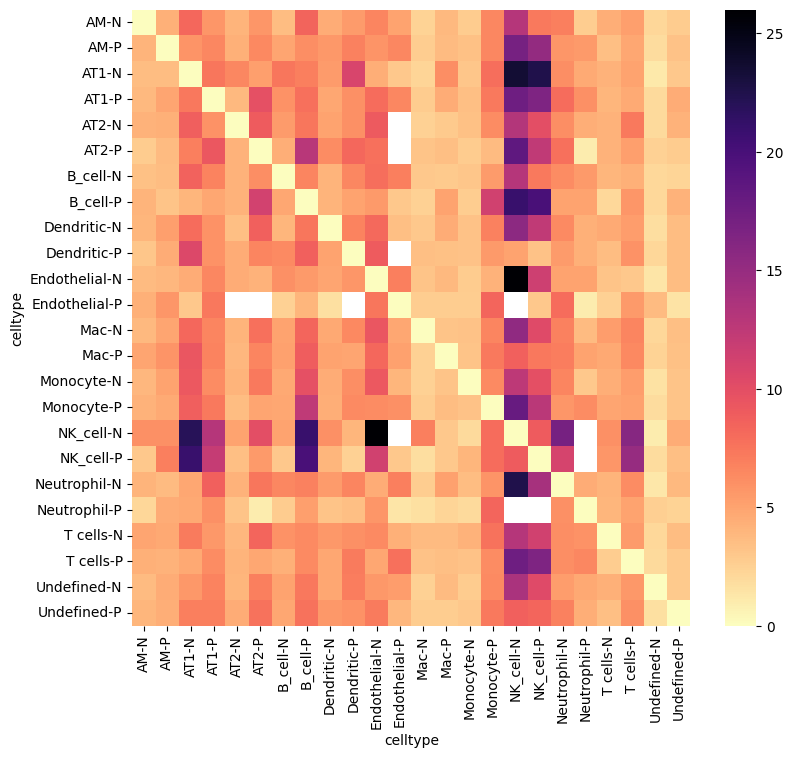

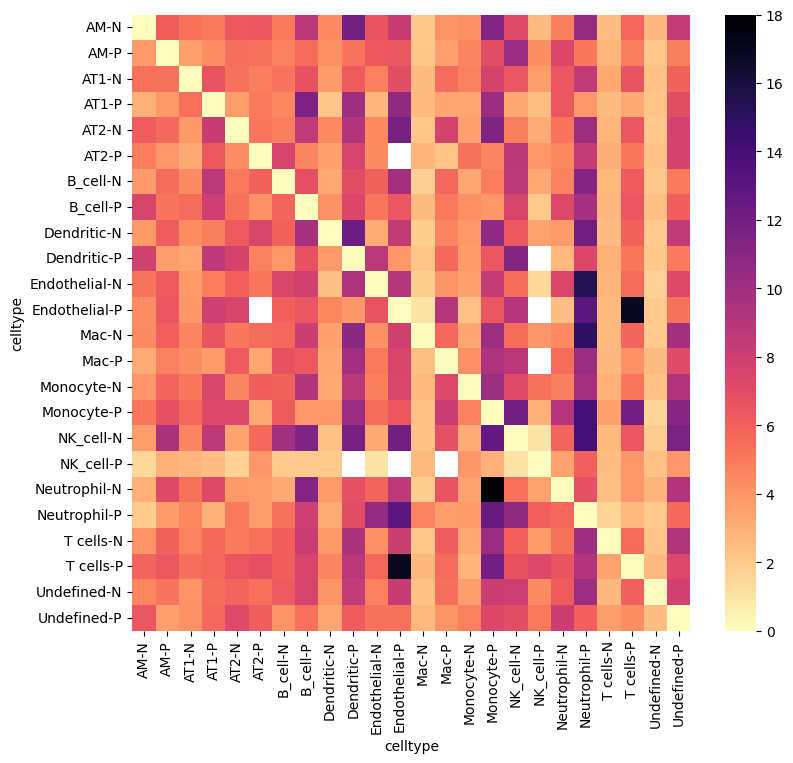

In [14]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


input_dir = 'cluster-niche'
files = [f for f in os.listdir(input_dir) if f.endswith('.csv')]
os.makedirs('./sopa_results/celltype-celltype-np', exist_ok=True)

for file in files:
    path = os.path.join(input_dir, file)
    sample = file.split('.')[0]
    print(sample)
    slice = sample.split('-')[0]
    id = sample.split('-')[1]
    nuclei_path = f'./mask/{slice}_{id}_mask.tif'
    adata = load_from_table(path = path, sample = sample, nuclei_path = nuclei_path)
    df = pd.read_csv(path)
    df = df[df['cell'] != '(nan, nan)']
    mapping = dict.fromkeys(['T_others', 'Treg', 'Tc', 'TH', 'Tdp'], 'T cells')
    df['claster'] = df['claster'].replace(mapping)
    df['claster'] = df['claster'].astype(str) + df['niche'].map(lambda x: '-N' if x == 'observer' else '-P')
    df.index = adata.obs_names
    adata.obs['celltype'] = df['claster']
    sopa.spatial.spatial_neighbors(adata, radius=[0, 50])
    cell_type_to_cell_type = sopa.spatial.mean_distance(adata, "celltype", "celltype")
    plt.figure(figsize=(9, 8))
    fig = sns.heatmap(cell_type_to_cell_type, cmap= 'magma_r')
    output_path = f'./sopa_results/celltype-celltype-np/{sample}.pdf'
    result = fig.get_figure()
    result.savefig(output_path, format = 'pdf')
    output_path = f'./sopa_results/celltype-celltype-np/{sample}.csv'
    cell_type_to_cell_type.to_csv(output_path)
    

In [19]:
import pandas as pd
import numpy as np
import os

directory = 'sopa_results/celltype-celltype-np'
directories = [d for d in os.listdir(directory) if os.path.isdir(os.path.join(directory, d))]

for d in directories:
    interaction_matrices = []
    subdir = os.path.join(directory, d)
    
    # 读取所有矩阵
    for filename in os.listdir(subdir):
        file_path = os.path.join(subdir, filename)
        df = pd.read_csv(file_path, index_col='celltype')
        interaction_matrices.append(df)
    
    # 初始化累加和与计数矩阵
    sum_matrix = pd.DataFrame(0.0, index=interaction_matrices[0].index, columns=interaction_matrices[0].columns)
    count_matrix = pd.DataFrame(0, index=interaction_matrices[0].index, columns=interaction_matrices[0].columns)
    
    # 累加并计数非 NaN
    for matrix in interaction_matrices:
        sum_matrix = sum_matrix.add(matrix, fill_value=0)
        count_matrix = count_matrix.add(matrix.notna().astype(int), fill_value=0)
    
    # 计算平均值，仅对 count_matrix > 0 的位置进行除法
    average_matrix = sum_matrix.divide(count_matrix).where(count_matrix > 0)
    
    # 保存结果
    output_path = f'./sopa_results/celltype-celltype-np/{d}-celltype-celltype-np-merged.csv'
    average_matrix.to_csv(output_path)


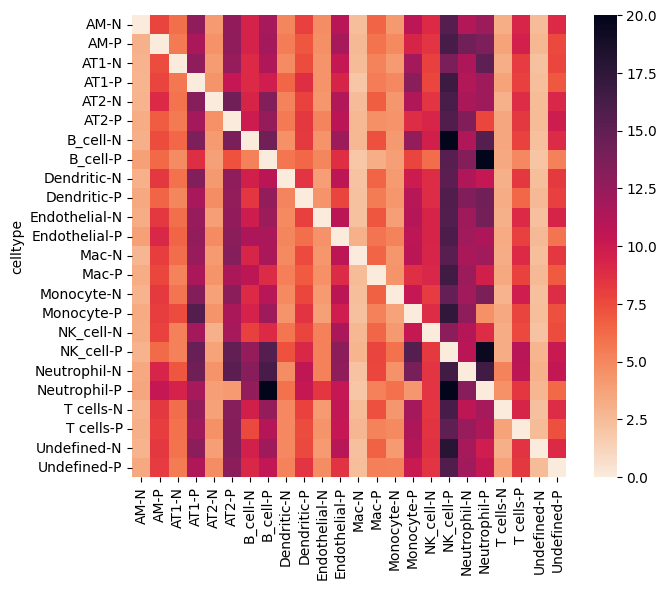

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns

sample = 'ea'
niches_to_niches = pd.read_csv(f'./sopa_results/celltype-celltype-np/{sample}-celltype-celltype-np-merged.csv', index_col= 'celltype')
plt.figure(figsize=(7, 6))
fig = sns.heatmap(niches_to_niches, cmap= 'rocket_r', vmin=0, vmax=20)
output_path = f'./sopa_results/celltype-celltype-np/{sample}.pdf'
result = fig.get_figure()
result.savefig(output_path, format = 'pdf')

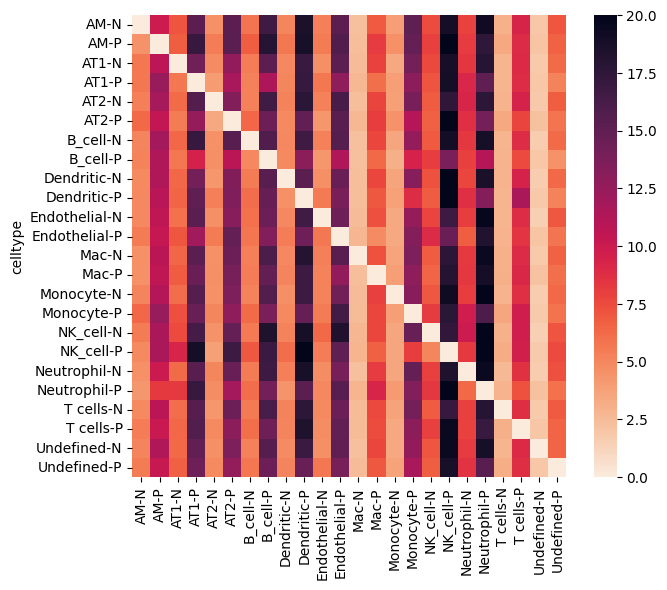

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns

sample = 'la'
niches_to_niches = pd.read_csv(f'./sopa_results/celltype-celltype-np/{sample}-celltype-celltype-np-merged.csv', index_col= 'celltype')
plt.figure(figsize=(7, 6))
fig = sns.heatmap(niches_to_niches, cmap= 'rocket_r', vmin=0, vmax=20)
output_path = f'./sopa_results/celltype-celltype-np/{sample}.pdf'
result = fig.get_figure()
result.savefig(output_path, format = 'pdf')

In [1]:
import numpy as np
import pandas as pd
from aicsimageio import imread
import matplotlib.pyplot as plt
from skimage.measure import regionprops, label
from skimage.segmentation import flood, flood_fill
from skimage.color import label2rgb
from skimage.morphology import erosion
from skimage.morphology import square, octagon
import scipy.ndimage as ndi

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [21]:
def get_new_mask(mask, df):
    ccs = regionprops(mask)
    val2cc = {}
    for cc in ccs:
        c_ = list(cc.centroid)
        val = mask[int(c_[0]), int(c_[1])]
        val2cc[val] = cc
    new_mask = np.zeros(mask.shape, dtype=mask.dtype)
    for _, row in df.iterrows():
        tp = row['claster']
        tp_idx = cell_types.index(tp) + 1
        c_ = [int(float(i)) for i in row['cell'].strip("()").split(",")]
        val = mask[c_[0], c_[1]]
        if val > 0:
            cc = val2cc[val]
            new_mask[cc.coords[:, 0], cc.coords[:, 1]] = tp_idx
        else:
            print(val)
    return new_mask 

def hex_to_array(h):
    h = h.lstrip("#")
    l = [int(h[i:i+2], 16)/255 for i in (0, 2, 4)]
    return np.array(l)

def get_border(mask):
    border = mask - erosion(mask, octagon(3, 1))
    #border = mask - erosion(mask)
    border = border > 0
    return border

def draw_type_mask(ax, mask, colors, labels, bg_color="#000000", back=None, border=None):
    colors_ = [hex_to_array(i) for i in colors]
    bg_color = hex_to_array(bg_color)
    rgb_img = label2rgb(mask, colors=colors_, bg_color=bg_color)
    if border is not None:
        rgb_img[border] = bg_color
    if back is not None:
        back_ratio = 0.4
        back_ = (back ^ back.min()) / (back.max() ^ back.min())
        back_ = np.stack([back_, back_, back_], axis=2)
        img = back_ * 0.8 + rgb_img * 0.8
        ax.imshow(img)
        ax.imshow(back, cmap="gray", alpha=1)
        ax.imshow(rgb_img, alpha=0.45)
    else:
        ax.imshow(rgb_img)
    ax.grid(False)
    # Add legend
    patches = [plt.Rectangle((0,0),1,1,fc=color) for color in colors]
    ax.legend(patches, labels, loc=2, bbox_to_anchor=(1.05,1.0),borderaxespad = 0.)
    # ax.axis('off')  # Do not display x and y axes
    ax.grid(False)
    plt.savefig(output_path, format='pdf')
    plt.show()

Text(0.5, 1.0, 'binary')

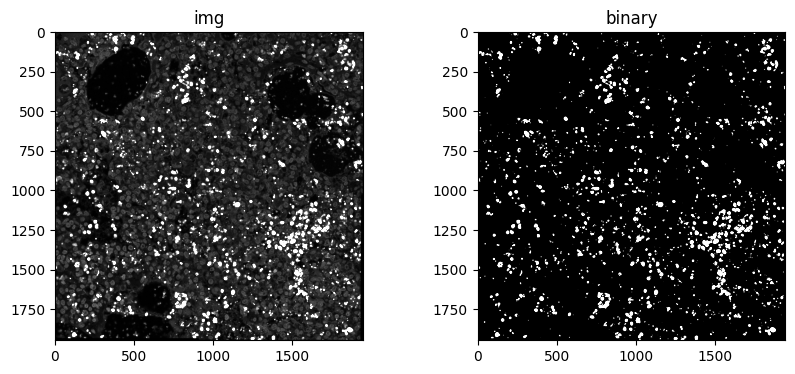

In [23]:
from skimage.filters import threshold_otsu, gaussian
from skimage.io import imread
img = imread('./diaowang-analysis/A6-1.tif')
img = img[0]

img = gaussian(img, sigma=1)
thresh = threshold_otsu(img)
binary = img > thresh

fig, ax = plt.subplots(1,2, figsize=(10, 4))
ax[0].imshow(img, cmap='gray', vmin=0, vmax=0.5)
ax[0].set_title("img", fontsize=12)
ax[1].imshow(binary, cmap='gray', vmin=0, vmax=0.5)
ax[1].set_title("binary", fontsize=12)

A6-1
(1948, 1947)
0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


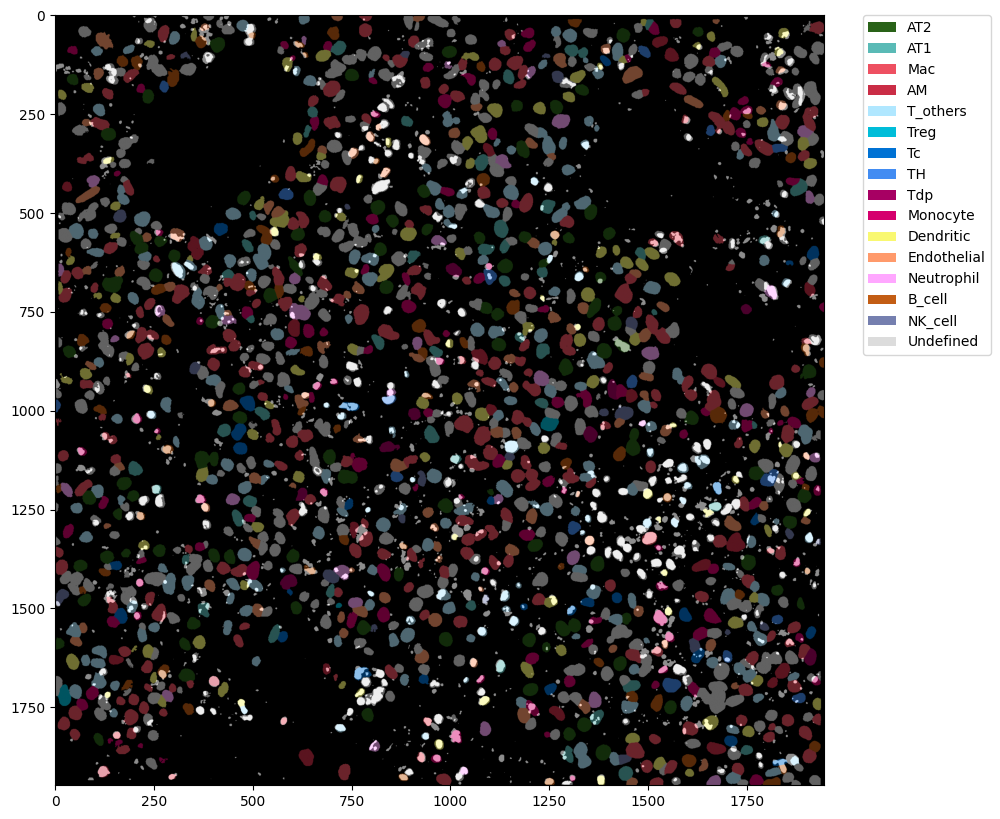

In [24]:
samples = ["A6-1"]
input_dir = './clusters20240317-annotated/infect'

cell_types = ['AT2',
 'AT1',
 'Mac',
 'AM',
 'T_others',
 'Treg',
 'Tc',
 'TH',
 'Tdp',
 'Monocyte',
 'Dendritic',
 'Endothelial',
 'Neutrophil',
 'B_cell',
 'NK_cell',
 'Undefined']

colors = ["#296218", "#5ABAB6", "#EE5061", "#CA2D46", 
          "#B0E7FF", "#00BDD9", "#0072D4", "#428CF2", 
          "#A70063", '#D5006D', "#F9F871", "#FF9A6B", "#FFA7FF", 
          "#C35D14", "#757FAF", "#DCDCDC"]


for sample in samples:
    print(sample)    
    cell_df = pd.read_csv(f"./{input_dir}/{sample}.csv", sep=",")
    last_row = cell_df.iloc[-1]
    file = sample.split('-')[0]
    id = sample.split('-')[1]
    mask = imread(f"./mask/{file}_{id}_mask.tif")
    print(mask.shape)
    new_mask = get_new_mask(mask, cell_df)
    m0 = new_mask
    fig, ax = plt.subplots(figsize=(20, 10))
    # ax.imshow(binary, alpha=1)
    output_path = './diaowang-A6-1.pdf'
    draw_type_mask(ax, m0, colors=colors, labels=cell_types, back=binary)
    ax.axis('off')

A6-1
(1948, 1947)
0


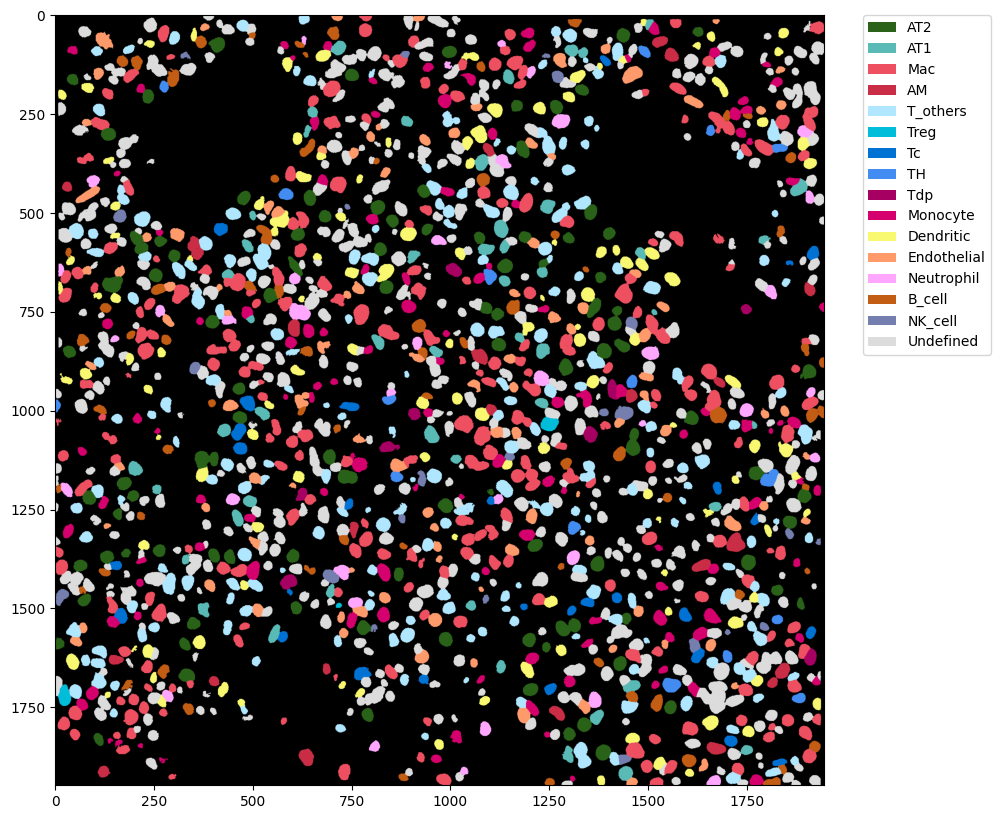

In [22]:
samples = ["A6-1"]
input_dir = './clusters20240317-annotated/infect'

cell_types = ['AT2',
 'AT1',
 'Mac',
 'AM',
 'T_others',
 'Treg',
 'Tc',
 'TH',
 'Tdp',
 'Monocyte',
 'Dendritic',
 'Endothelial',
 'Neutrophil',
 'B_cell',
 'NK_cell',
 'Undefined']

colors = ["#296218", "#5ABAB6", "#EE5061", "#CA2D46", 
          "#B0E7FF", "#00BDD9", "#0072D4", "#428CF2", 
          "#A70063", '#D5006D', "#F9F871", "#FF9A6B", "#FFA7FF", 
          "#C35D14", "#757FAF", "#DCDCDC"]


for sample in samples:
    print(sample)    
    cell_df = pd.read_csv(f"./{input_dir}/{sample}.csv", sep=",")
    last_row = cell_df.iloc[-1]
    file = sample.split('-')[0]
    id = sample.split('-')[1]
    mask = imread(f"./mask/{file}_{id}_mask.tif")
    print(mask.shape)
    new_mask = get_new_mask(mask, cell_df)
    m0 = new_mask
    fig, ax = plt.subplots(figsize=(20, 10))
    # ax.imshow(binary, alpha=1)
    output_path = './A6-1.pdf'
    draw_type_mask(ax, m0, colors=colors, labels=cell_types)
    ax.axis('off')

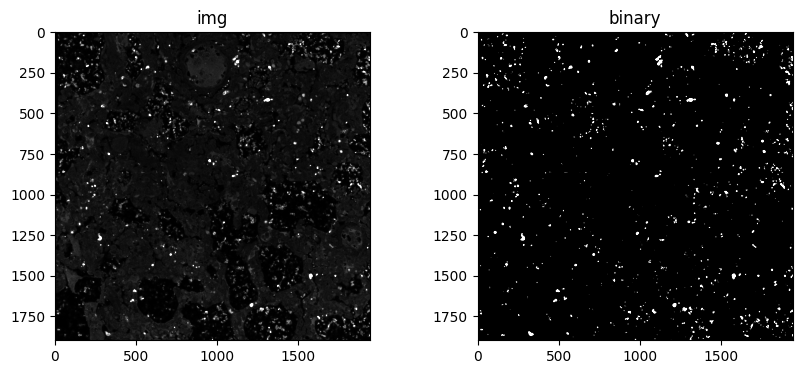

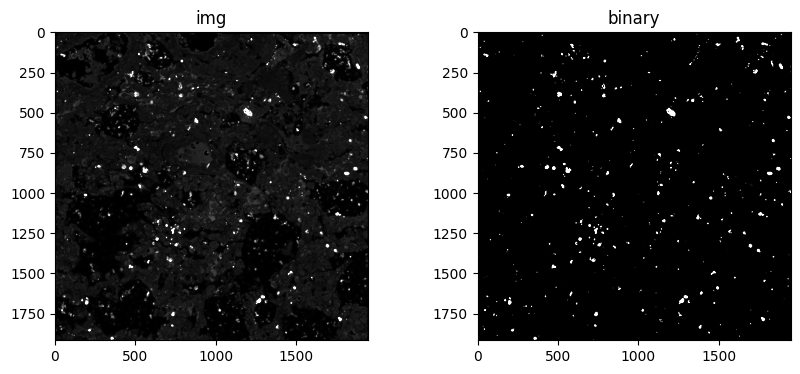

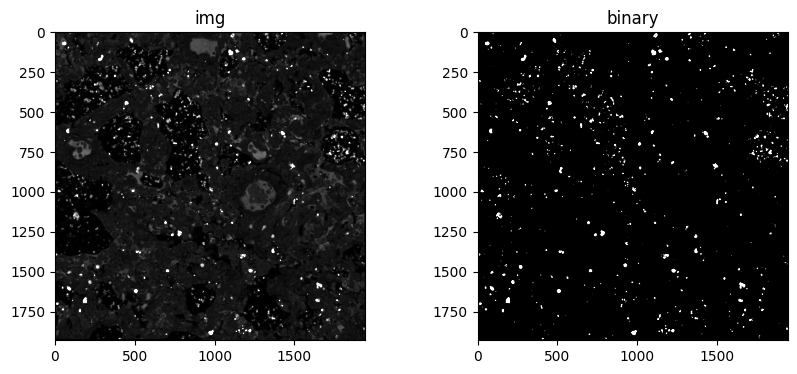

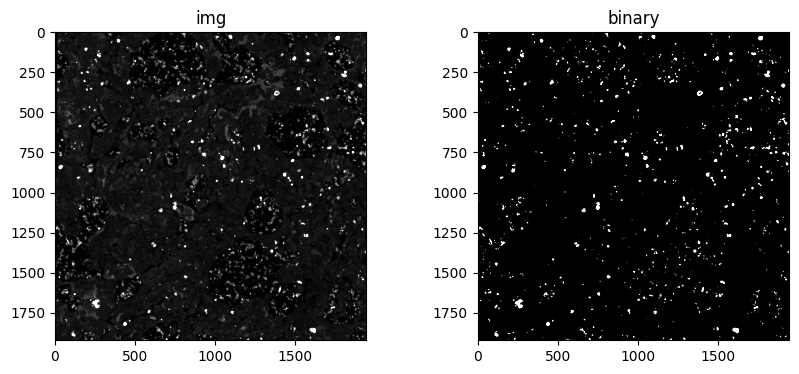

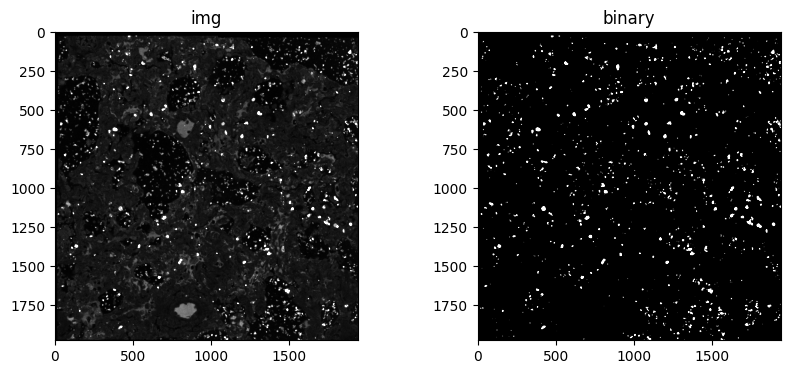

...

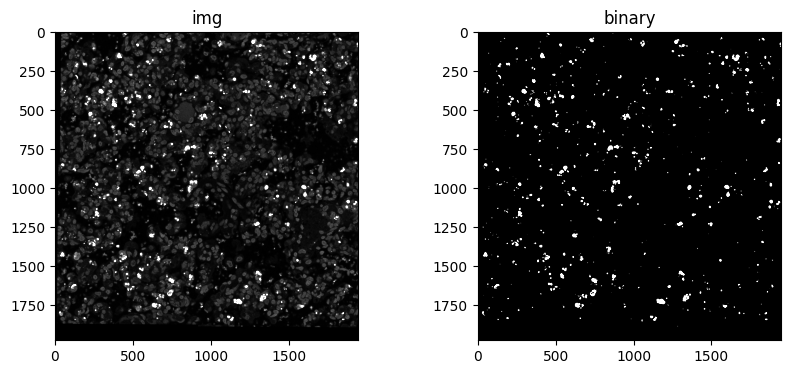

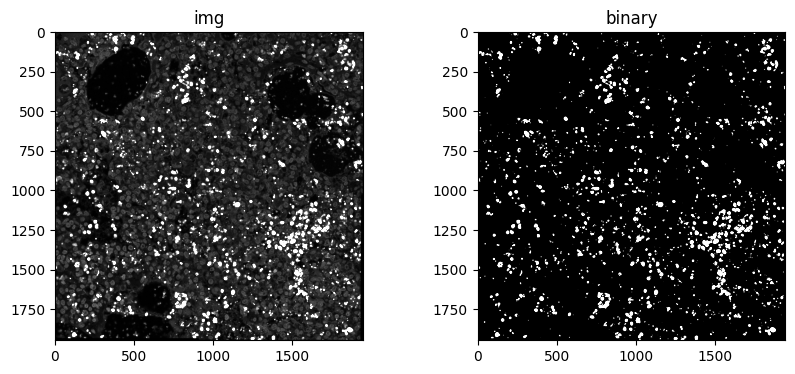

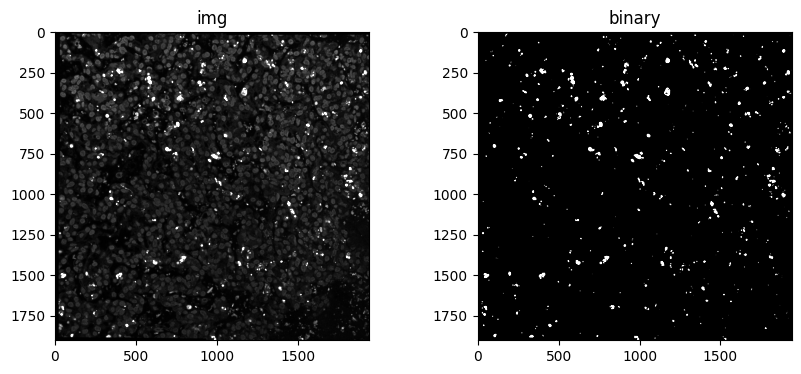

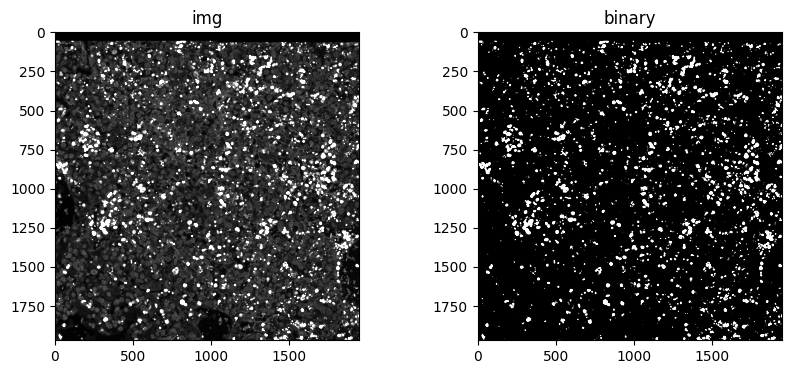

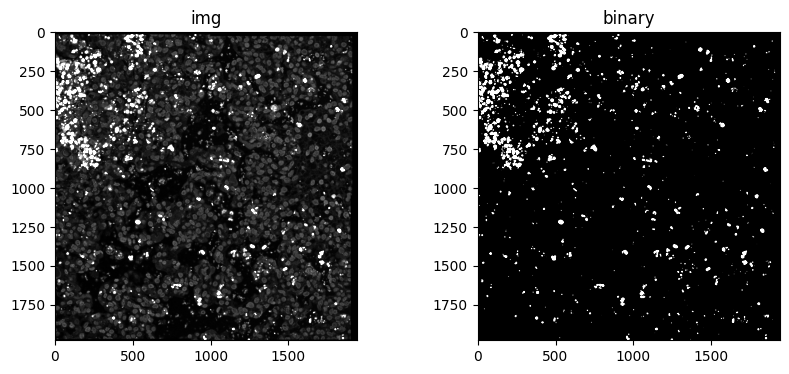

In [14]:
import os
from skimage.io import imread
from skimage.filters import gaussian,threshold_otsu
import matplotlib.pyplot as plt

samples = ["A2-1", "A2-2", "A2-3", "A2-4", "A3-1", "A3-2","A3-3", 
           "A4-1","A4-2", "A4-3", "A5-1", "A5-2", "A5-3", "A6-1", 
           "A6-2", "A6-3", "A6-4"]


def check_coordinate(img, coordinate):
    y, x = coordinate
    x = int(x)
    y = int(y)
    if img[y, x] == 1:
        return True
    else:
        return False


for sample in samples:
    img_dir = 'tmp/diaowang-analysis'
    img_path = f'{sample}.tif'

    csv_dir = './cluster-niche'
    csv_path = f'{sample}.csv'

    img = imread(os.path.join(img_dir, img_path))
    csv = pd.read_csv(os.path.join(csv_dir, csv_path))
    # csv = csv[csv['cell'] != '(nan, nan)']

    img = img[0]
    img = gaussian(img, sigma=1)
    thresh = threshold_otsu(img)
    binary = img > thresh

    fig, ax = plt.subplots(1,2, figsize=(10, 4))
    ax[0].imshow(img, cmap='gray', vmin=0, vmax=0.5)
    ax[0].set_title("img", fontsize=12)
    ax[1].imshow(binary, cmap='gray', vmin=0, vmax=0.5)
    ax[1].set_title("binary", fontsize=12)
        
    data = []

    for index, row in csv.iterrows():
        cell = row['cell']
        coordinates = tuple(map(float, cell.strip('()').split(',')))
        if check_coordinate(binary, coordinates):
            # print("True")
            data.append('True')
        else:
            # print("False")
            data.append('False')

    csv['diaowang'] = data
    csv.to_csv(f'./diaowang_res/{sample}-diaowang.csv')

In [26]:
import pandas as pd
import numpy as np

from scipy.stats import gaussian_kde
from sklearn.cluster import KMeans, DBSCAN
from skimage.io import imread
from skimage.measure import regionprops
from skimage.color import label2rgb
from skimage.morphology import erosion
from skimage.morphology import octagon
from scipy.spatial.distance import cdist

import matplotlib.pyplot as plt


def get_new_mask(mask, df, cell_types):
    ccs = regionprops(mask)
    val2cc = {}
    for cc in ccs:
        c_ = cc.centroid
        # c_ = list(cc.centroid)
        val = mask[int(c_[0]), int(c_[1])]
        val2cc[val] = cc
    new_mask = np.zeros(mask.shape, dtype=mask.dtype)
    for _, row in df.iterrows():
        tp = row['claster']
        try: 
            tp_idx = cell_types.index(tp) + 1 
        except ValueError: 
            print(f"Error: '{tp}' is not in the cell_types list. Trying with stripped space...") 
            tp = tp.replace(" ", "") # 去除空格重新尝试 
            try: 
                tp_idx = cell_types.index(tp) + 1 
            except ValueError: 
                print(f"Error: '{tp}' is still not in the cell_types list. Skipping this entry.") 
                continue
        # tp_idx = cell_types.index(tp) + 1
        c_ = [int(float(i)) for i in row['cell'].strip("()").split(",")]
        val = mask[c_[0], c_[1]]
        if val > 0:
            cc = val2cc[val]
            new_mask[cc.coords[:, 0], cc.coords[:, 1]] = tp_idx
        else:
            print(val)
    return new_mask

def hex_to_array(h):
    h = h.lstrip("#")
    l = [int(h[i:i+2], 16)/255 for i in (0, 2, 4)]
    return np.array(l)

def get_border(mask):
    border = mask - erosion(mask, octagon(3, 1))
    #border = mask - erosion(mask)
    border = border > 0
    return border

def draw_type_mask(ax, mask, colors, labels, output_path, bg_color="#000000", back=None, border=None):
    colors_ = [hex_to_array(i) for i in colors]
    bg_color = hex_to_array(bg_color)
    rgb_img = label2rgb(mask, colors=colors_, bg_color=bg_color)
    if border is not None:
        rgb_img[border] = bg_color
    if back is not None:
        back_ratio = 0.4
        back_ = (back ^ back.min()) / (back.max() ^ back.min())
        back_ = np.stack([back_, back_, back_], axis=2)
        img = back_ * 0.8 + rgb_img * 0.8
        ax.imshow(img)
        ax.imshow(back, cmap="gray", alpha=0.5)
        ax.imshow(rgb_img, alpha=0.75)
    else:
        ax.imshow(rgb_img)
    ax.grid(False)
    # Add legend
    patches = [plt.Rectangle((0,0),1,1,fc=color) for color in colors]
    ax.legend(patches, labels, loc=2, bbox_to_anchor=(1.05,1.0),borderaxespad = 0.)
    ax.axis('off')  # Do not display x and y axes
    ax.grid(False)
    plt.savefig(output_path, format='pdf')
    plt.show()

def find_density_centers(file_path, gene_name, sample, top_n=1, n_clusters=3, min_distance=60):
    """
    Finds the density centers for a given gene in the dataset within different regions.

    Parameters:
    - file_path: str, path to the CSV file
    - gene_name: str, the gene to filter the data by
    - top_n: int, number of top density centers to return per region
    - n_clusters: int, number of clusters/regions to divide the data into
    - min_distance: float, minimum distance between density centers

    Returns:
    - filtered_coords_list: list of numpy.ndarray, coordinates of the filtered density centers for each region
    """
    data = pd.read_csv(file_path)
    gene_data = data[data['gene'] == gene_name]
    
    if gene_data.shape[0] < 2:
        print(f"The dataset for gene {gene_name} has insufficient data points for KDE.")
        return None
    else:
        x = gene_data['dim_2'].values
        y = gene_data['dim_1'].values
        xy = np.vstack([x, y]).T

        # Perform K-means clustering to divide the data into regions
        kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(xy)
        labels = kmeans.labels_

        top_coords_list = []

        plt.figure(figsize=(10, 6))

        for i in range(n_clusters):
            cluster_data = xy[labels == i]
            if cluster_data.shape[0] < 2:
                print(f"Cluster {i} has insufficient data points for KDE.")
                continue
            
            # Perform KDE for the current cluster
            kde = gaussian_kde(cluster_data.T, bw_method='scott')
            xmin, xmax = cluster_data[:, 0].min() - 1, cluster_data[:, 0].max() + 1
            ymin, ymax = cluster_data[:, 1].min() - 1, cluster_data[:, 1].max() + 1
            xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
            positions = np.vstack([xx.ravel(), yy.ravel()])
            density = kde(positions).reshape(xx.shape)
            density_flat = density.flatten()
            sorted_indices = np.argsort(density_flat)[::-1]  # Sort in descending order
            top_indices = sorted_indices[:top_n * 10]  # Take more top density points to filter later
            top_coords = np.vstack([positions[0][top_indices], positions[1][top_indices]]).T
            
            # Use DBSCAN to cluster close density centers
            dbscan = DBSCAN(eps=min_distance, min_samples=1)
            db_labels = dbscan.fit_predict(top_coords)
            
            filtered_coords = []
            for label in np.unique(db_labels):
                cluster_coords = top_coords[db_labels == label]
                # Take the mean coordinate of each DBSCAN cluster as the representative point
                cluster_center = cluster_coords.mean(axis=0)
                filtered_coords.append(cluster_center)
                if len(filtered_coords) >= top_n:
                    break
            
            filtered_coords = np.array(filtered_coords)
            top_coords_list.append(filtered_coords)

            # Add KDE and top density centers for the current cluster to the global plot
            plt.imshow(np.rot90(density), cmap='Blues', extent=[xmin, xmax, ymin, ymax], alpha=0.5)
            plt.scatter(filtered_coords[:, 0], filtered_coords[:, 1], s=50, label=f'Top Density Centers')

        plt.title(f'Kernel Density Estimation for {gene_name} Gene (All Clusters)')
        plt.xlabel('dim_2 (x-axis)')
        plt.ylabel('dim_1 (y-axis)')
        plt.legend()
        plt.savefig(f'{sample}-kde.pdf', format='pdf')
        plt.show()
        return top_coords_list
    
def calculate_surrounding_cell_types(df, center_cells, radii=[60, 120, 180]):
    """
    Calculate the surrounding cell types within given radii for each center cell and
    return the difference in counts between each pair of consecutive radii.

    Parameters:
    - df: DataFrame, contains the cell data with columns 'cell' and 'claster'
    - center_cells: numpy.ndarray, array of shape (n, 2) where each row is [y, x] coordinates of center cells
    - radii: list of int, the radii within which to search for surrounding cells

    Returns:
    - results: list of dictionaries, each containing the center cell info and surrounding cell type counts for each radius
    """
    results = []
    df[['y', 'x']] = df['cell'].str.strip('()').str.split(',', expand=True).astype(float)

    for center in center_cells:
        center_x, center_y = center
        df['distance'] = np.sqrt((df['x'] - center_x)**2 + (df['y'] - center_y)**2)
        
        prev_counts = {}
        cell_type_counts = {radius: {} for radius in radii}
        
        for i, radius in enumerate(radii):
            surrounding_cells = df[(df['distance'] <= radius) & (df['distance'] > 0)]
            counts = surrounding_cells['claster'].value_counts().to_dict()
            
            if i == 0:
                cell_type_counts[radius] = counts
            else:
                diff_counts = {}
                for cell_type, count in counts.items():
                    prev_count = prev_counts.get(cell_type, 0)
                    diff_counts[cell_type] = count - prev_count
                cell_type_counts[radius] = diff_counts
            
            prev_counts = counts
        
        results.append({
            'center_y': center_y,
            'center_x': center_x,
            'surrounding_cell_types': cell_type_counts
        })
    
    return results

def calculate_gene_expression_around_centers(file_path, centers, radius_list, gene_list):
    """
    Calculates gene expression statistics for a given list of genes within specified radii around each density center.

    Parameters:
    - file_path: str, path to the CSV file
    - centers: list of numpy.ndarray, coordinates of the density centers
    - radius_list: list of int, list of radii to calculate the expression statistics for
    - gene_list: list of str, list of genes to calculate the expression statistics for

    Returns:
    - expression_df: pandas DataFrame, gene expression statistics within the given radii around each density center
    """
    data = pd.read_csv(file_path)
    all_expression_stats = []

    for center in np.vstack(centers):
        prev_radius_mask = np.zeros(data.shape[0], dtype=bool)
        for radius in radius_list:
            distances = cdist([center], data[['dim_2', 'dim_1']].values).flatten()
            within_radius_mask = (distances <= radius) & ~prev_radius_mask
            within_radius = data[within_radius_mask]
            for gene in gene_list:
                count = within_radius[within_radius['gene'] == gene].shape[0]
                all_expression_stats.append({
                    'center_x': center[0],
                    'center_y': center[1],
                    'radius': radius,
                    'gene': gene,
                    'count': count
                })
            prev_radius_mask = distances <= radius
    
    # Convert the gene expression statistics to a DataFrame
    expression_df = pd.DataFrame(all_expression_stats)
    
    return expression_df

def analyze_samples(samples, input_dir, cell_types, colors, top_density_centers, radii=[50, 100, 150], dpi=96):
    all_results = []

    for sample in samples:
        print(sample)    
        cell_df = pd.read_csv(f"{input_dir}/{sample}.csv", sep=",")
        cell_df = cell_df[cell_df['cell'] != '(nan, nan)']
        file = sample.split('-')[0]
        id = sample.split('-')[1]
        mask = imread(f"{input_dir}/{file}_{id}_mask.tif")
        print(mask.shape)
        new_mask = get_new_mask(mask, cell_df, cell_types)

        fig, ax = plt.subplots(figsize=(20, 10), dpi=dpi)
        for centers in top_density_centers:
            print(centers)
            y = centers[:, 0]
            x = centers[:, 1]
            spots = 5
            spots_center = (spots / (dpi / 72))**2
            for radius in radii:
                area_in_points = (radius / (dpi / 72))**2
                ax.scatter(y, x, s=area_in_points, marker='o', edgecolors='white', facecolors='none', linewidths=4, linestyle='--')
            ax.scatter(y, x, s=spots_center, marker='o', edgecolors='white', facecolors='none', linewidths=3)

        output_path = f'./{sample}.pdf'
        draw_type_mask(ax, new_mask, colors=colors, labels=cell_types, output_path=output_path)

        for centers in top_density_centers:
            results = calculate_surrounding_cell_types(cell_df, centers, radii)
            all_results.extend(results)
    
    csv_data = []
    for result in all_results:
        for radius, counts in result['surrounding_cell_types'].items():
            row = {
                'center_y': result['center_y'],
                'center_x': result['center_x'],
                'radius': radius
            }
            row.update(counts)
            csv_data.append(row)

    df_csv = pd.DataFrame(csv_data)
    df_csv.to_csv(f'./{sample}_surrounding_cell_types.csv', index=False)

In [29]:
samples = ["A2-1", "A2-2", "A2-3", "A2-4", 
           "A3-1", "A3-2","A3-3", "A4-1",
           "A4-2", "A4-3", "A5-1", "A5-2", 
           "A5-3", "A6-1", "A6-2", "A6-3", 
           "A6-4"]

cell_types = ['AT2', 'AT1', 'Mac', 'AM', 'T_others', 'Tc', 
              'TH', 'Tdp', 'Monocyte', 'Dendritic', 'Endothelial', 
              'Neutrophil', 'B_cell', 'NK_cell', 'Undefined', 'Treg']


colors = ["#296218", "#5ABAB6", "#EE5061", "#CA2D46", 
          "#B0E7FF", "#0072D4", "#428CF2", "#D5006D",
          "#A70063", "#F9F871", "#FF9A6B", "#FFA7FF", 
          "#C35D14", "#757FAF", "#DCDCDC", "#00BDD9"]

gene_name = 'B646L'
input_dir = 'input'

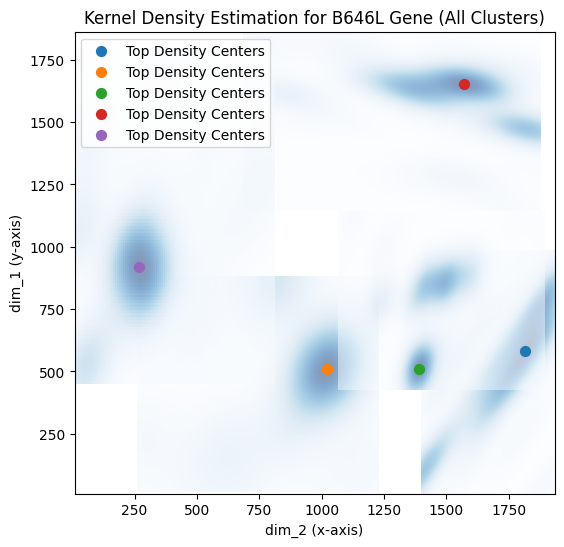

A2-1
(1899, 1943)
0
0
0
0
0
0
[[1815.64530423  582.49040404]]
[[1021.60952121  511.10659646]]
[[1390.05461081  510.1030303 ]]
[[1568.5299803  1651.39918182]]
[[268.07828283 917.55474545]]


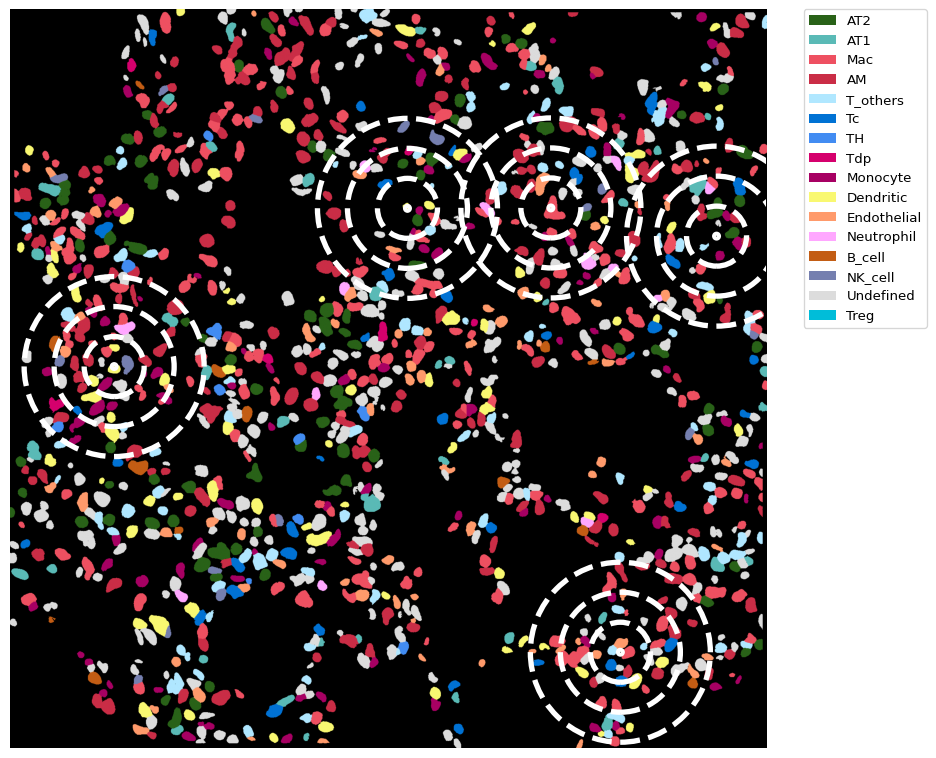

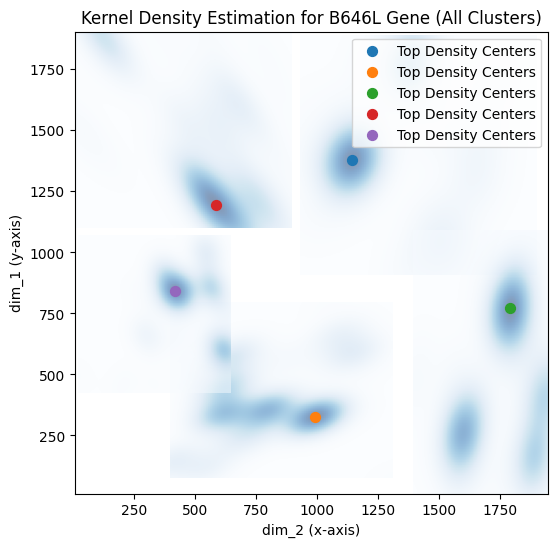

A2-2
(1916, 1948)
0
0
0
[[1142.00505051 1378.18393283]]
[[992.86511455 325.3815201 ]]
[[1790.8520202   772.70923424]]
[[ 585.97370152 1194.07727273]]
[[420.30151515 840.30261263]]


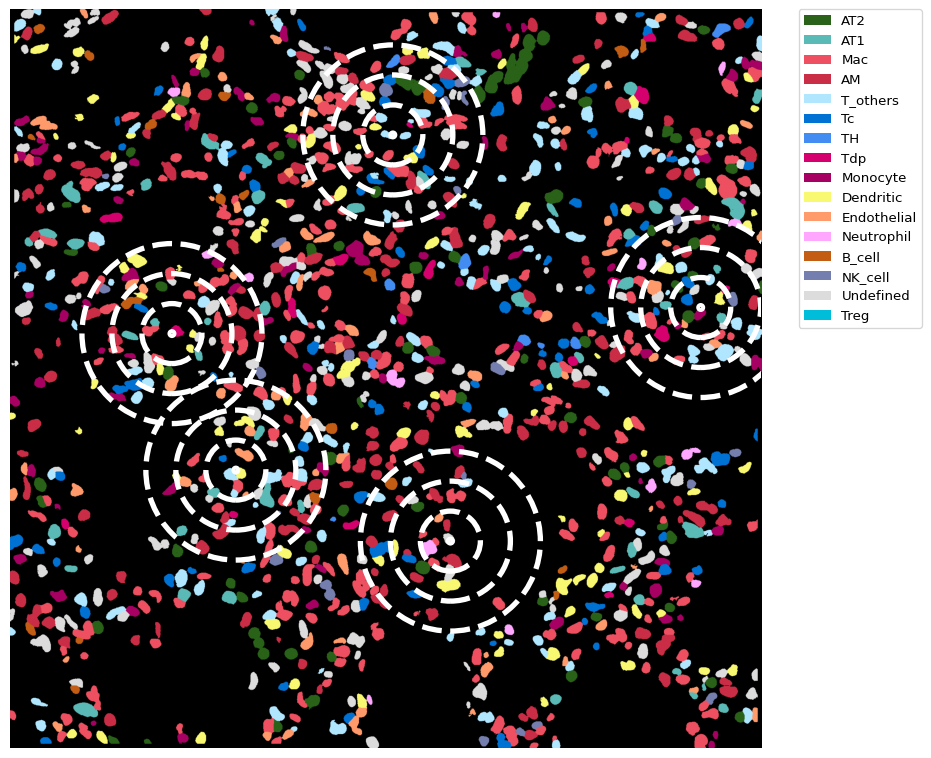

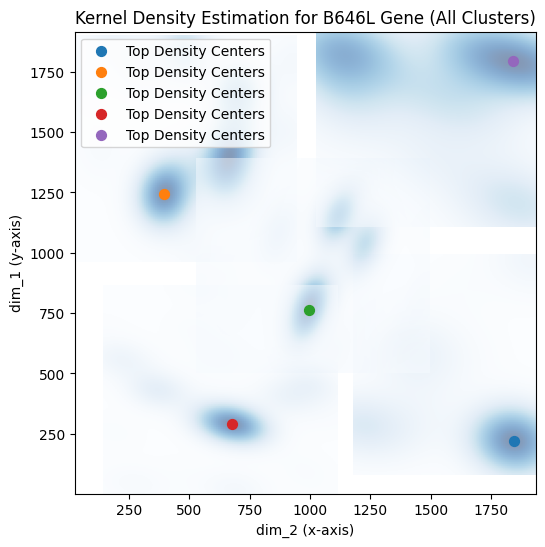

A2-3
(1930, 1944)
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
[[1845.04368929  219.15656061]]
[[ 395.05050505 1242.04646465]]
[[994.42339232 763.4040404 ]]
[[676.59555707 290.24136667]]
[[1842.1790404  1792.03080808]]


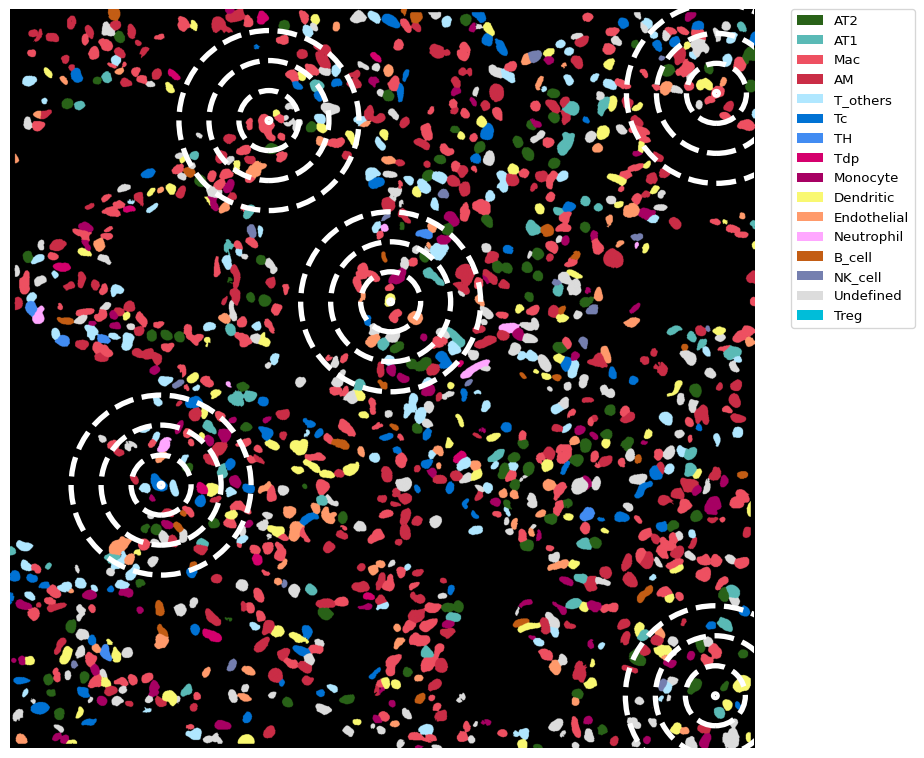

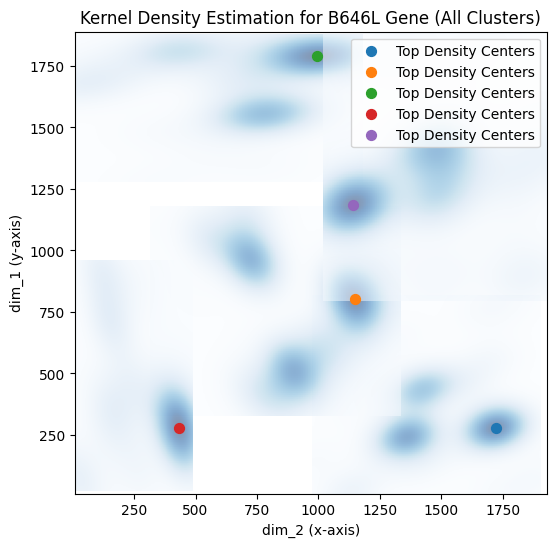

A2-4
(1923, 1945)
0
0
0
0
0
0
0
0
0
0
0
[[1720.5719697   278.02761798]]
[[1147.95454545  802.83333333]]
[[ 993.12237273 1792.70919434]]
[[431.20606455 278.2469697 ]]
[[1139.51110667 1185.11767677]]


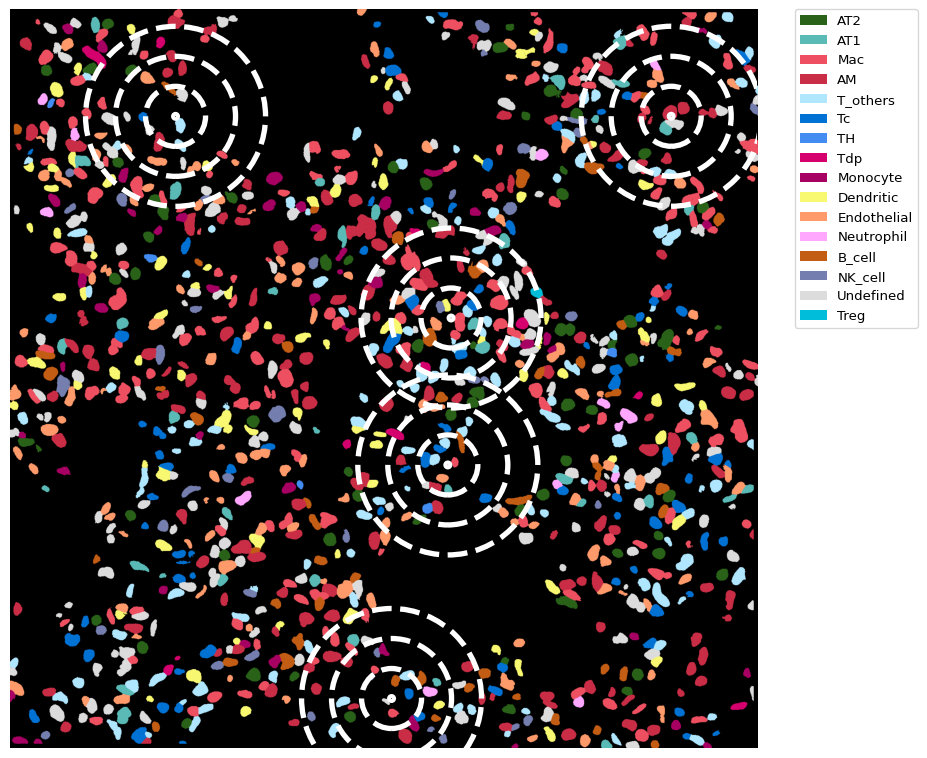

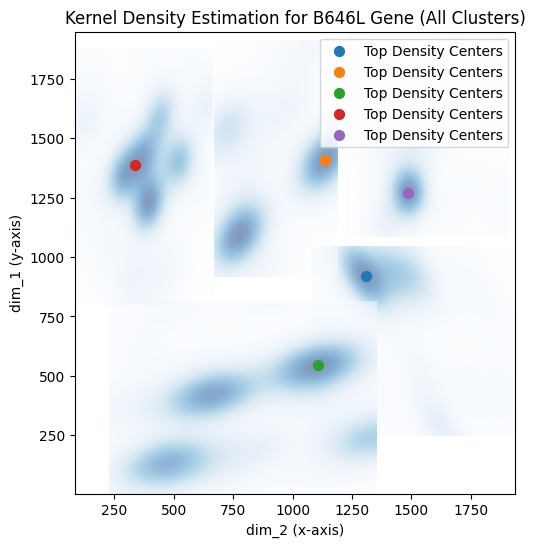

A3-1
(1974, 1942)
0
0
0
0
0
0
0
0
0
0
0
0
0
[[1308.00189333  921.0863204 ]]
[[1136.77272727 1409.46969697]]
[[1106.28762212  544.01797535]]
[[ 335.89545455 1385.75151515]]
[[1487.50757576 1269.8040404 ]]


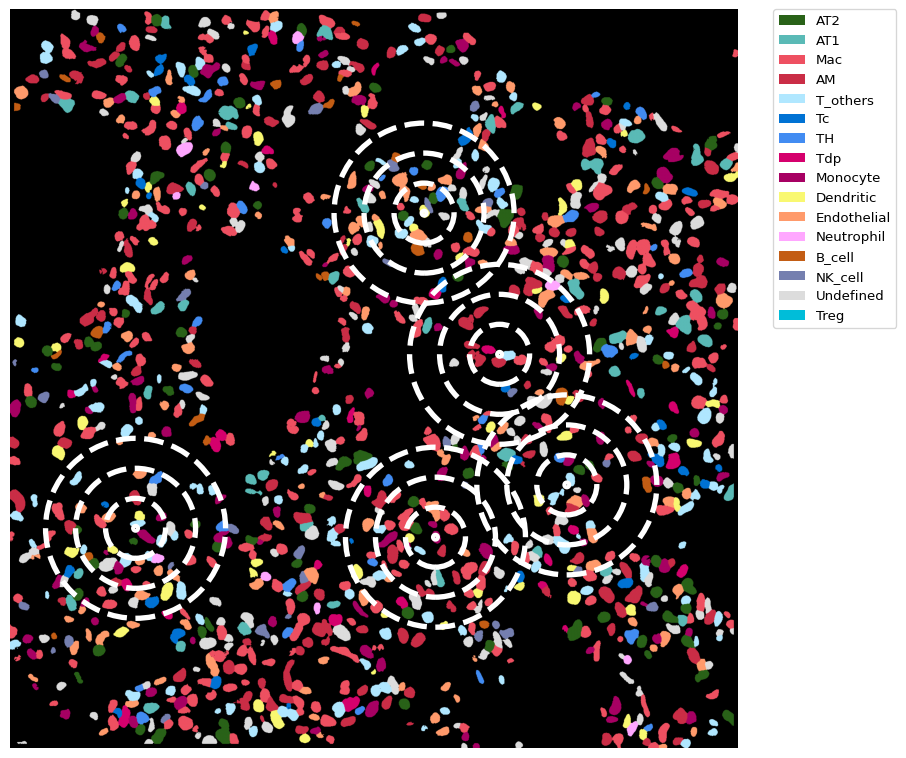

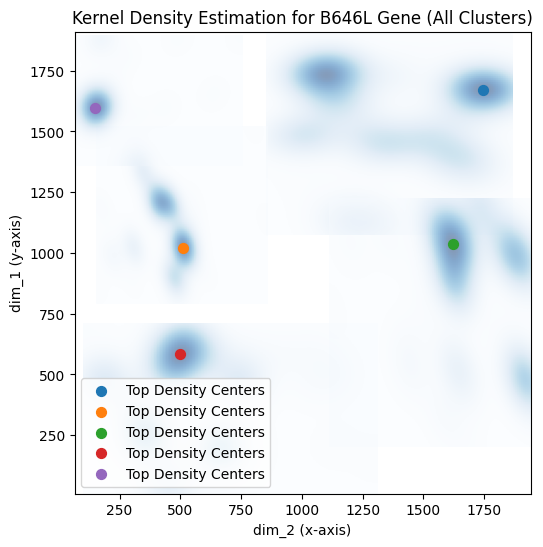

A3-2
(1922, 1942)
0
0
0
0
[[1746.71953232 1672.22424242]]
[[ 510.72424242 1021.63052273]]
[[1623.18822195 1035.3582096 ]]
[[498.76767677 586.08030303]]
[[ 149.78383838 1596.97979798]]


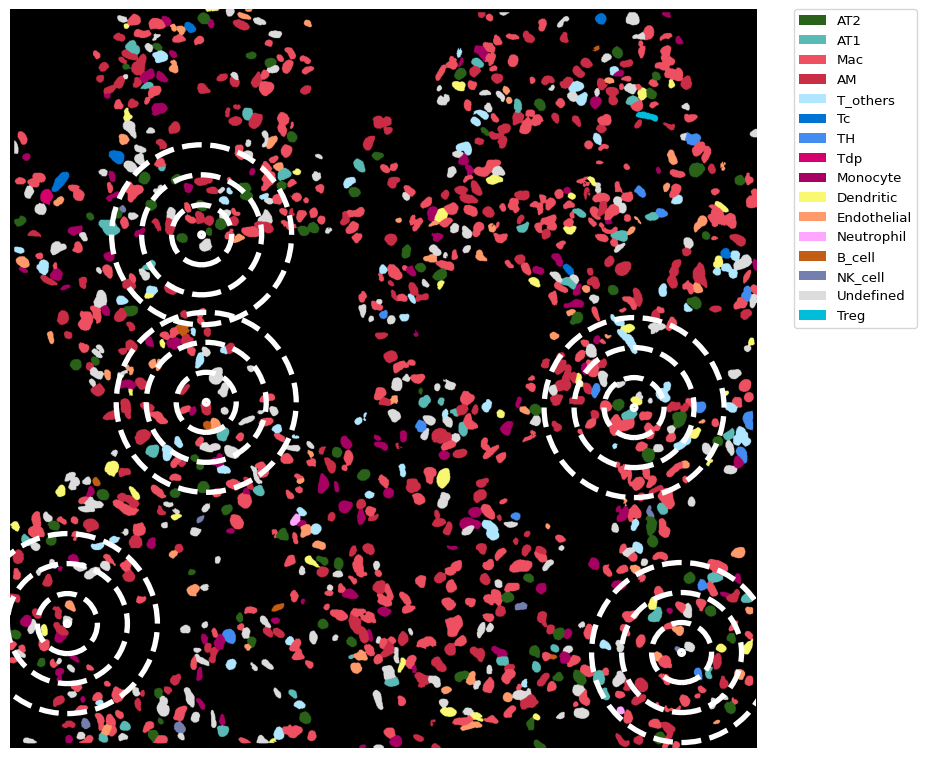

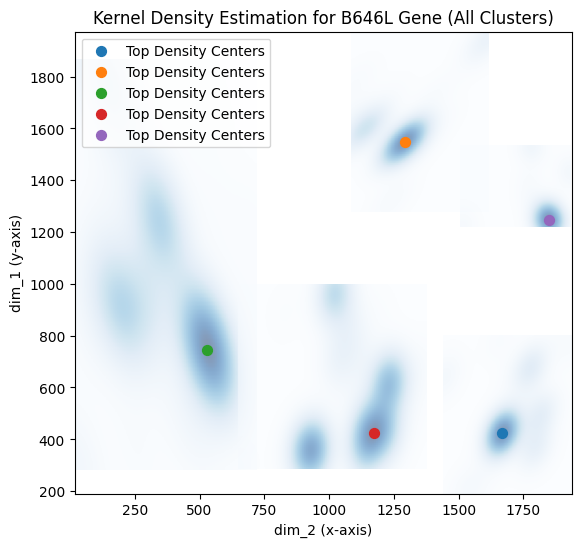

A3-3
(1978, 1945)
0
0
0
0
0
0
0
[[1668.33838384  425.52990505]]
[[1291.44028061 1547.52047667]]
[[529.89393939 744.35353535]]
[[1173.15050505  422.68048788]]
[[1848.18787879 1245.00252525]]


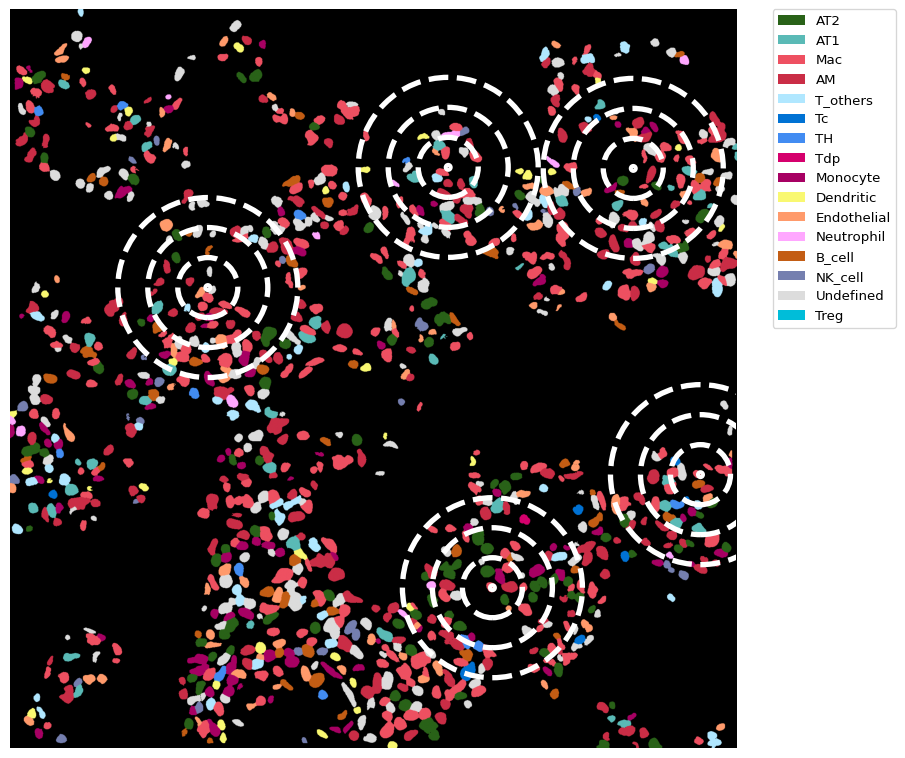

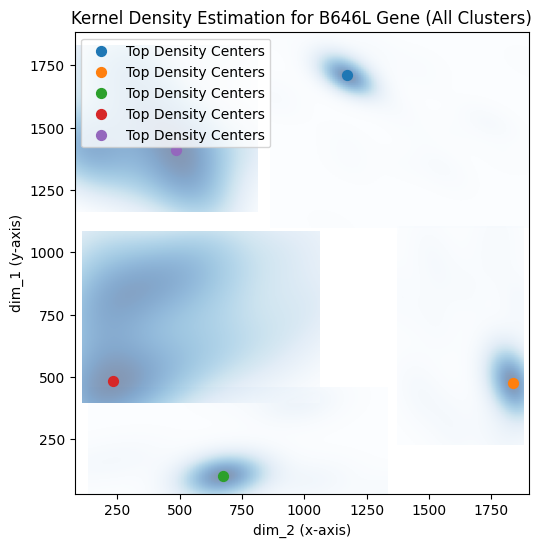

A4-1
(1963, 1945)
0
0
0
0
0
0
0
[[1170.6010101  1710.33333333]]
[[1835.55555556  475.04040404]]
[[672.29292929 103.16666667]]
[[234.14141414 482.74242424]]
[[ 485.58787879 1410.0030303 ]]


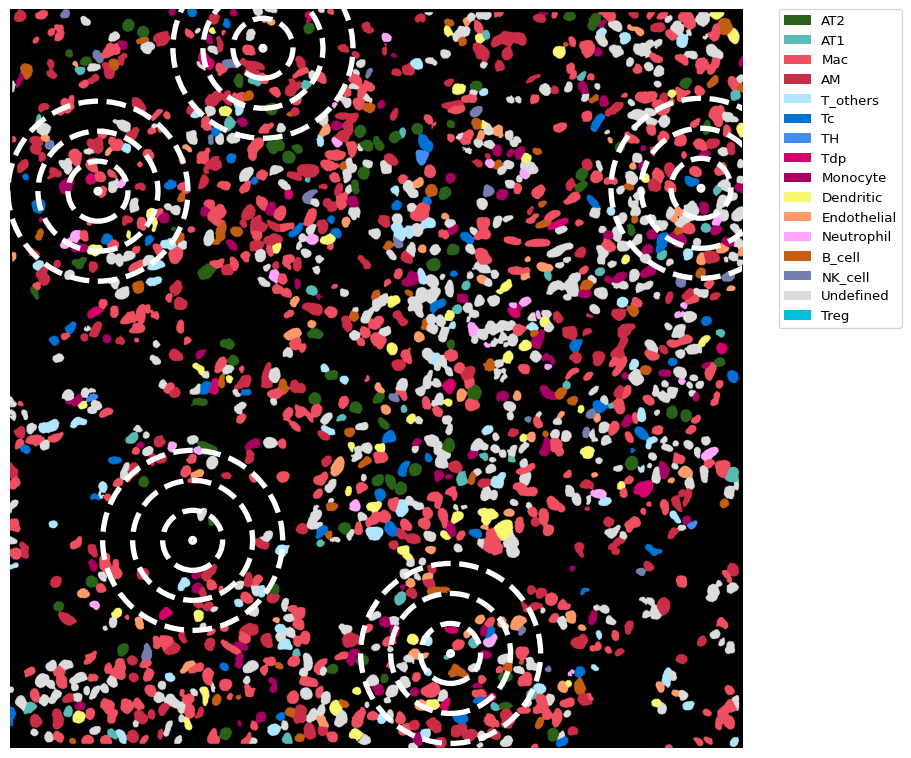

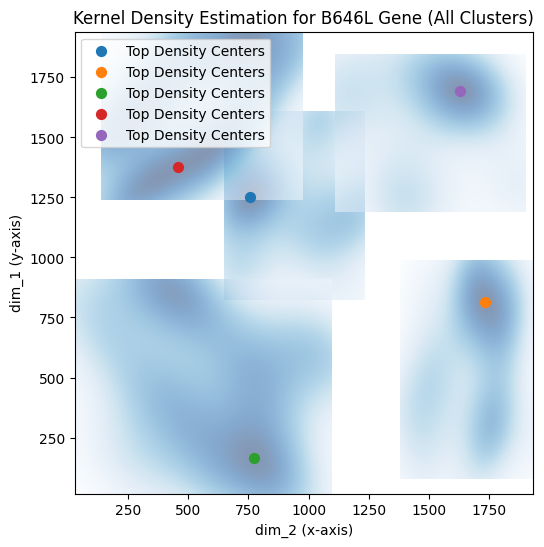

A4-2
(1969, 1945)
0
0
0
[[ 758.3        1250.76767677]]
[[1734.98484848  814.16161616]]
[[771.06060606 165.83333333]]
[[ 454.96363636 1375.15151515]]
[[1630.         1692.36363636]]


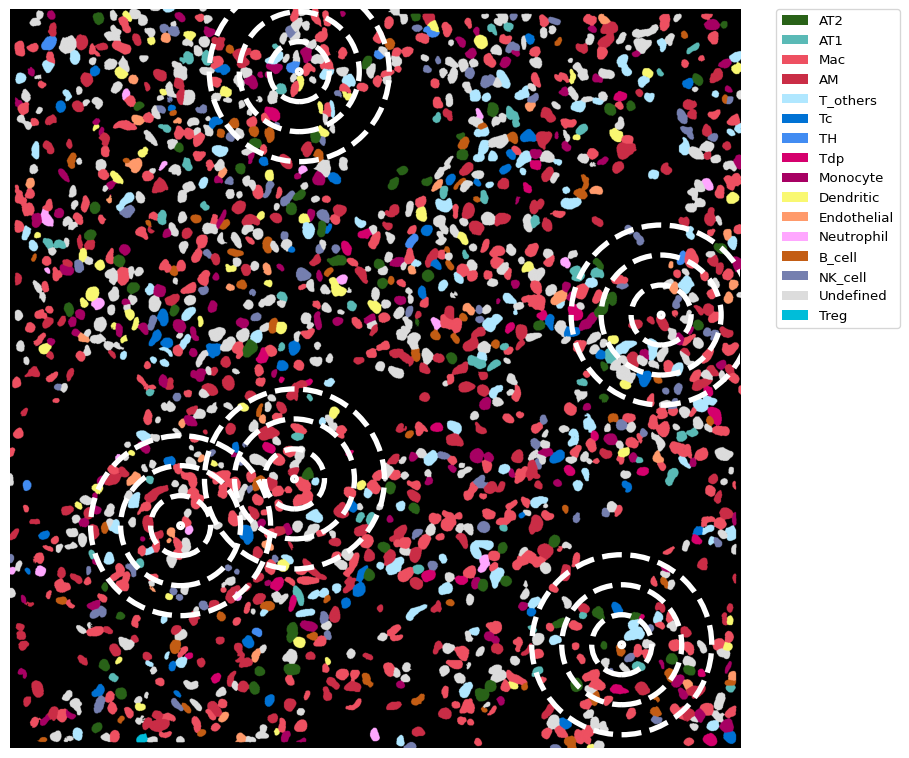

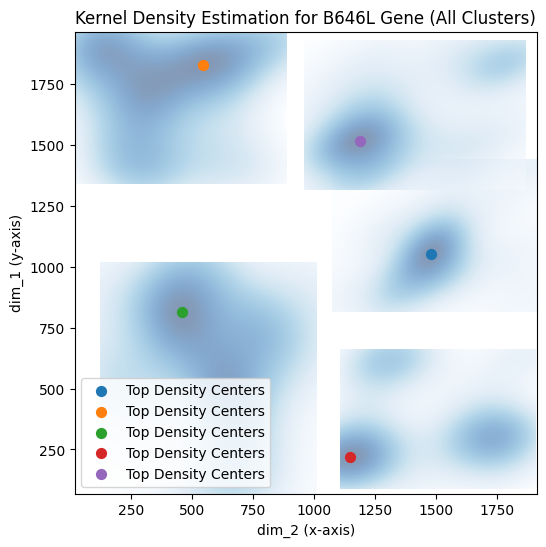

A4-3
(1987, 1944)
0
0
0
0
0
0
0
0
0
[[1480.27272727 1049.74242424]]
[[ 542.18383838 1826.59393939]]
[[458.12121212 811.9040404 ]]
[[1147.93535354  219.15555556]]
[[1186.54141414 1515.9989899 ]]


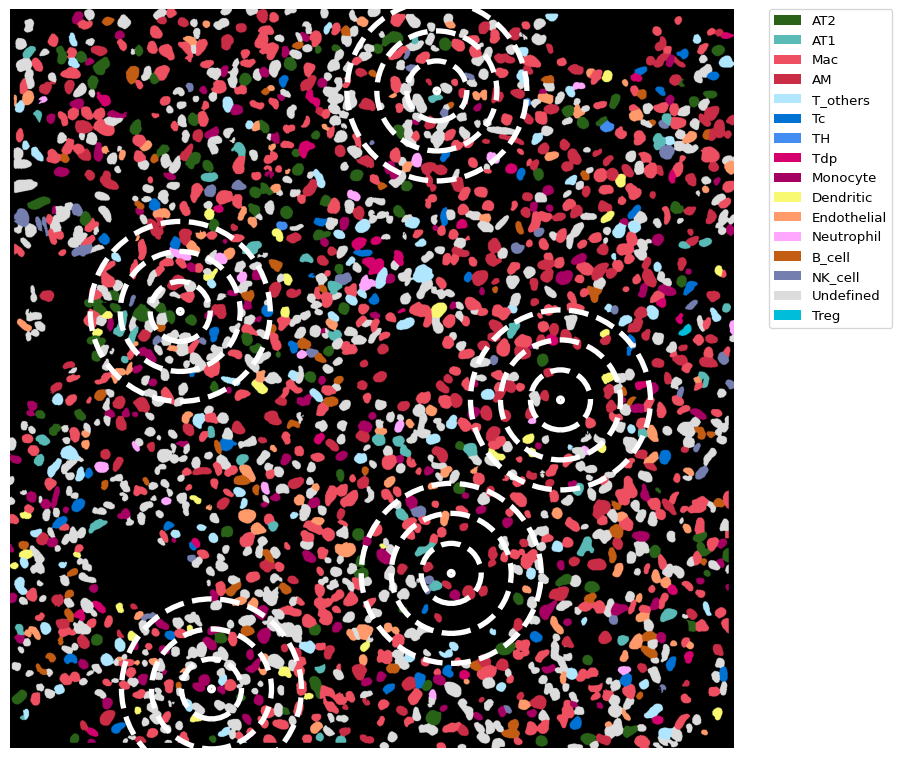

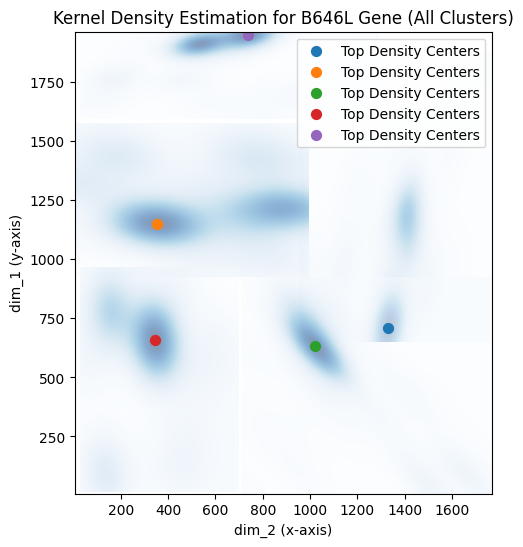

A5-1
(1962, 1944)
0
0
0
0
0
0
0
0
0
0
0
0
0
0
[[1330.82828283  706.81818182]]
[[ 353.93636364 1148.54545455]]
[[1021.9010101   630.25858586]]
[[346.03030303 659.49090909]]
[[ 737.74545455 1945.88585859]]


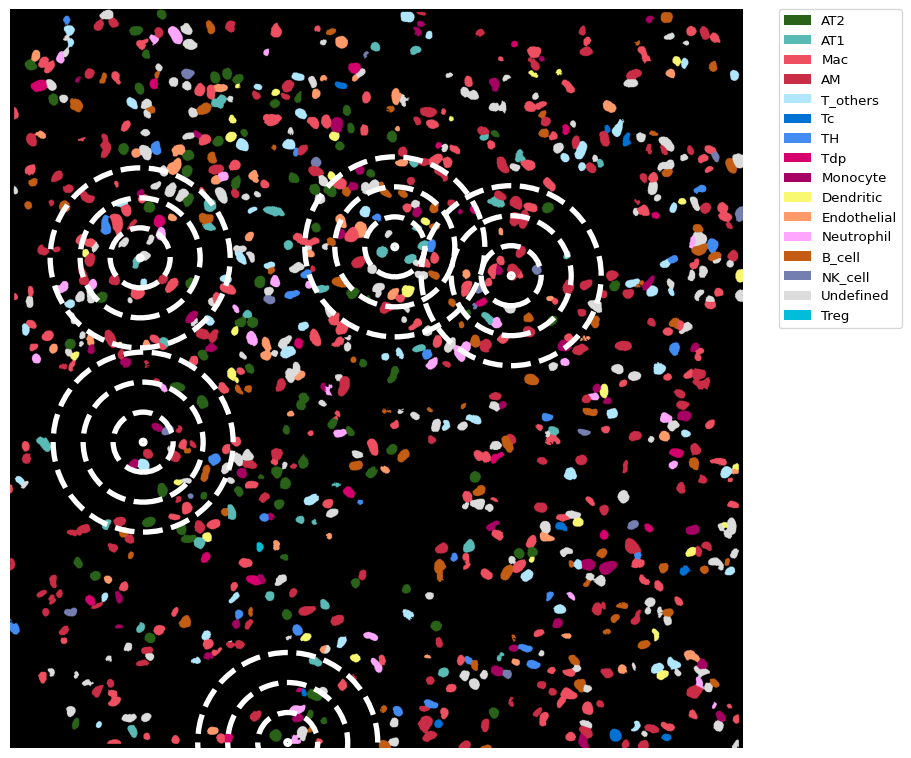

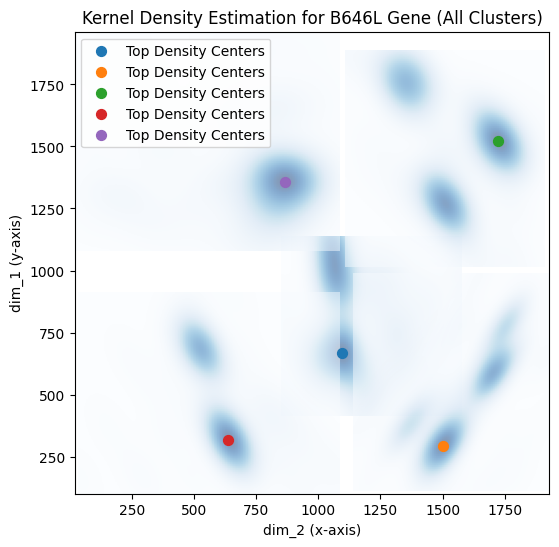

A5-2
(1965, 1944)
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
[[1094.13737374  665.60606061]]
[[1501.4         294.27878788]]
[[1725.64848485 1522.04545455]]
[[637.4        316.97878788]]
[[ 867.08484848 1356.49494949]]


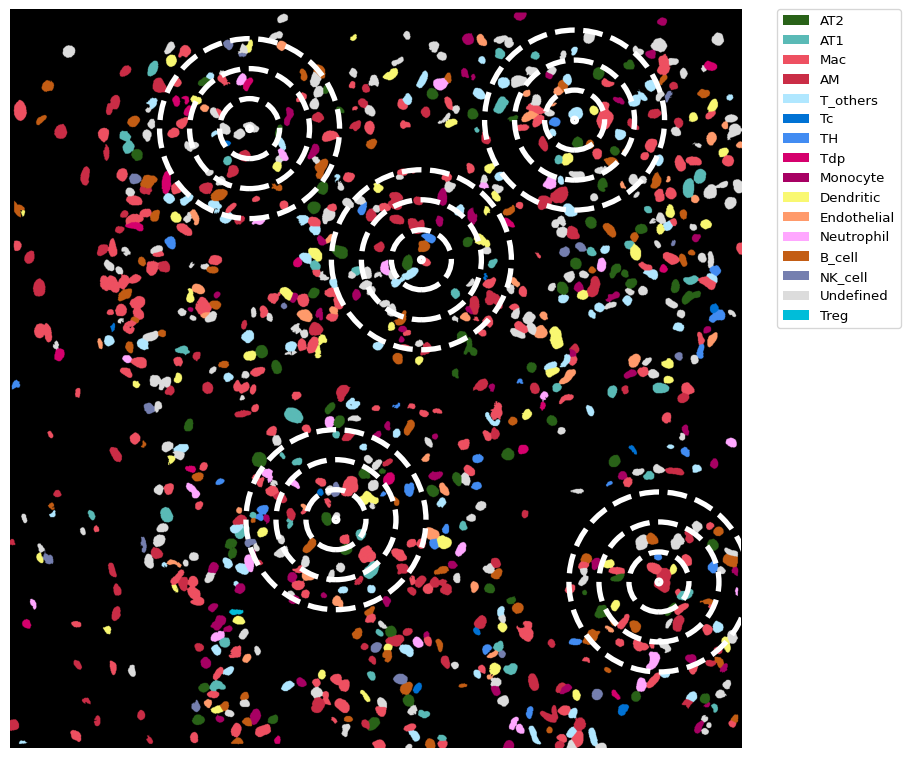

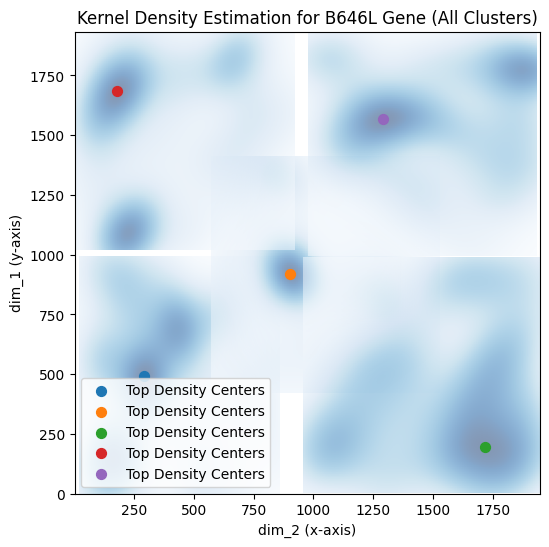

A5-3
(1976, 1948)
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
[[291.19191919 490.46464646]]
[[903.15151515 917.98989899]]
[[1718.76969697  193.04040404]]
[[ 177.56565657 1684.21717172]]
[[1292.76969697 1567.66464646]]


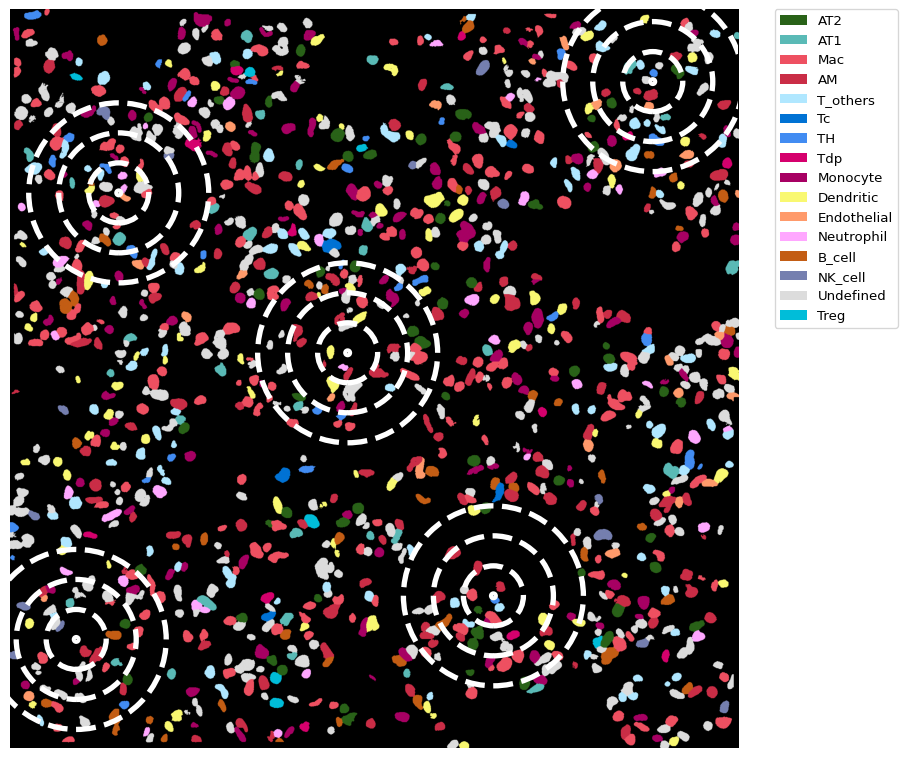

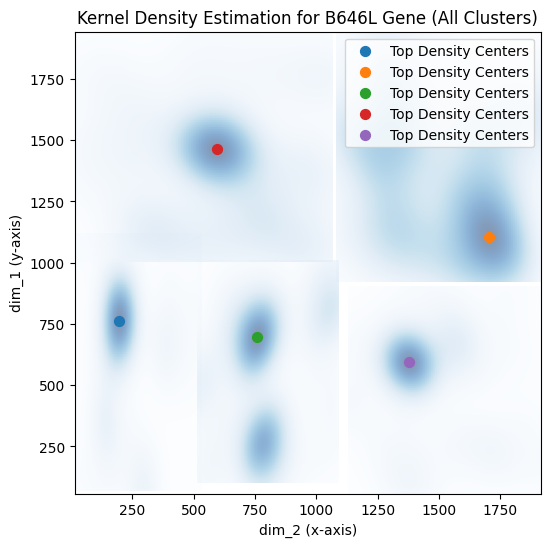

A6-1
(1948, 1947)
0
[[195.73333333 761.6969697 ]]
[[1704.63636364 1104.57373737]]
[[759.78787879 697.98181818]]
[[ 594.7040404  1461.97676768]]
[[1376.39393939  593.35353535]]


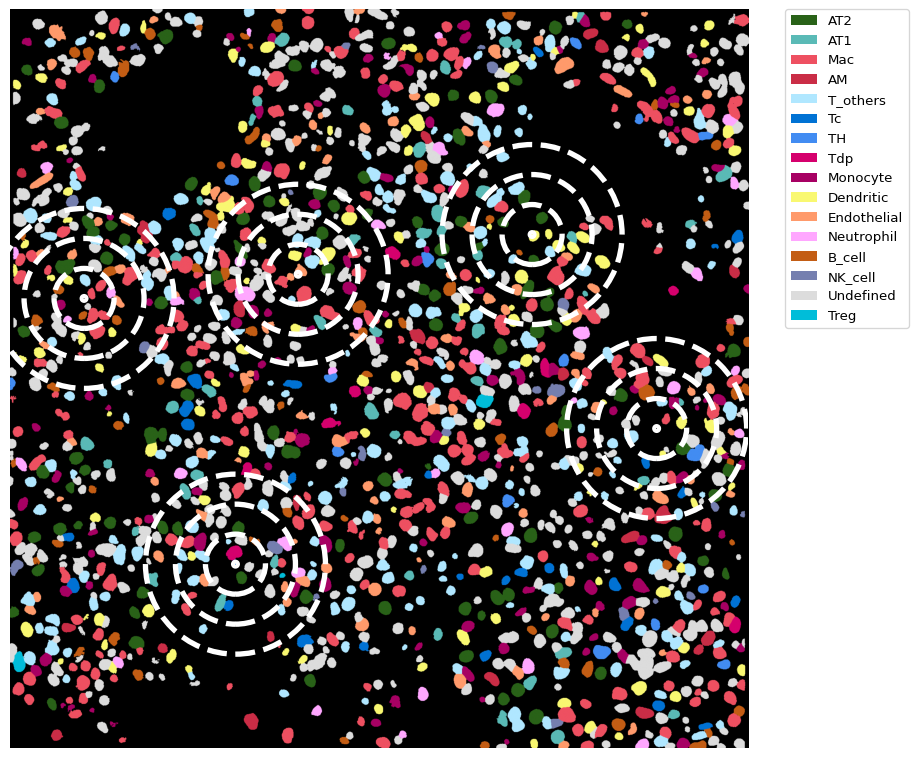

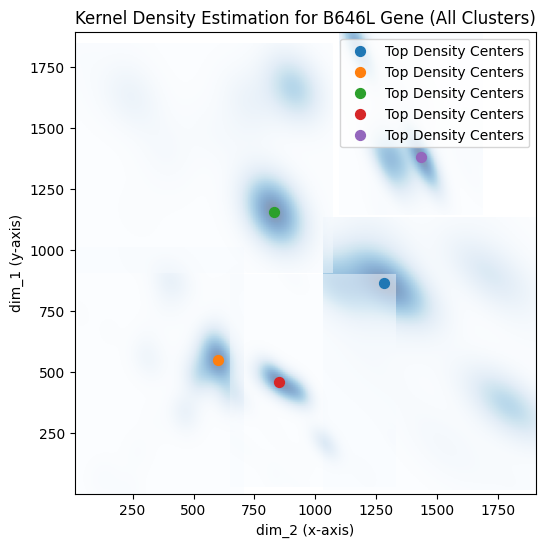

A6-2
(1903, 1942)
0
0
0
0
0
0
0
0
0
0
[[1282.18181818  862.96969697]]
[[602.06363636 549.93333333]]
[[ 830.42424242 1153.98282828]]
[[850.97575758 457.83434343]]
[[1433.00505051 1382.43737374]]


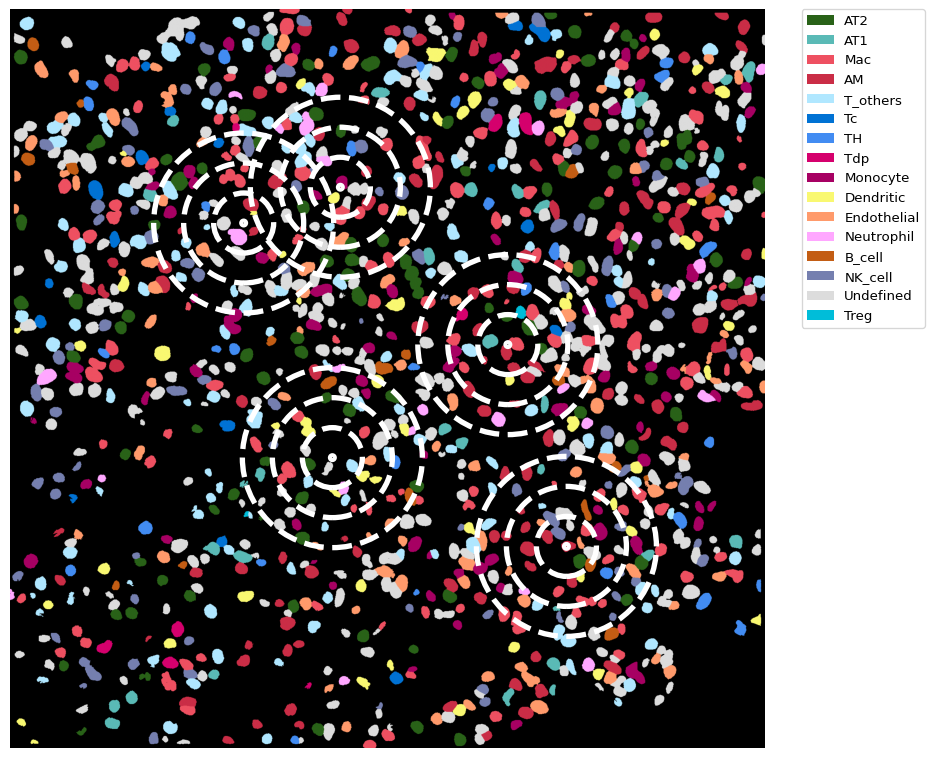

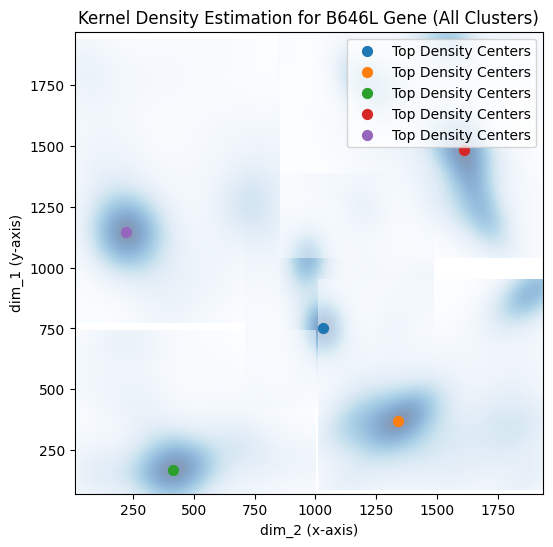

A6-3
(1970, 1945)
0
0
0
0
0
0
0
[[1031.94141414  750.84848485]]
[[1339.24444444  369.74545455]]
[[415.36363636 169.42424242]]
[[1609.7        1481.93030303]]
[[ 220.07474747 1147.35555556]]


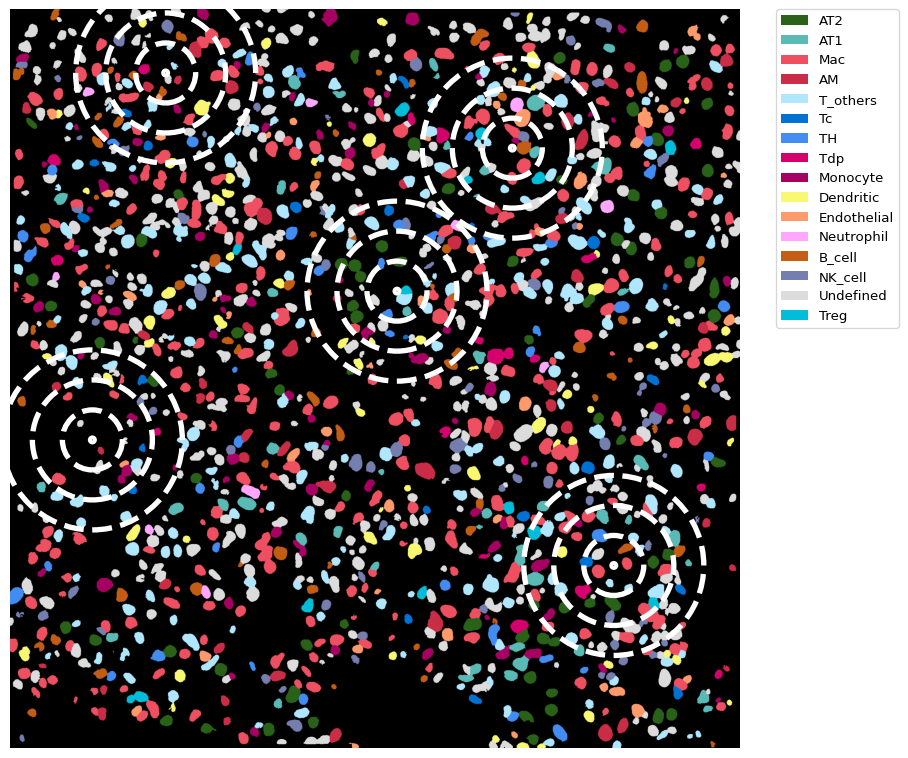

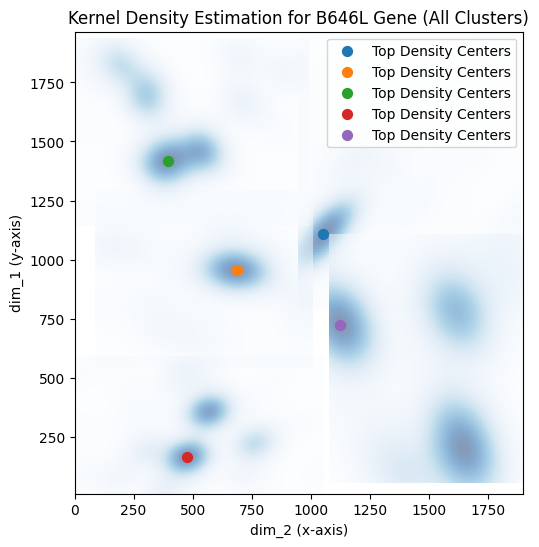

A6-4
(1978, 1942)
[[1053.42424242 1109.88888889]]
[[685.53535354 955.5979798 ]]
[[ 397.         1417.43939394]]
[[477.15151515 165.25252525]]
[[1121.95252525  725.36363636]]


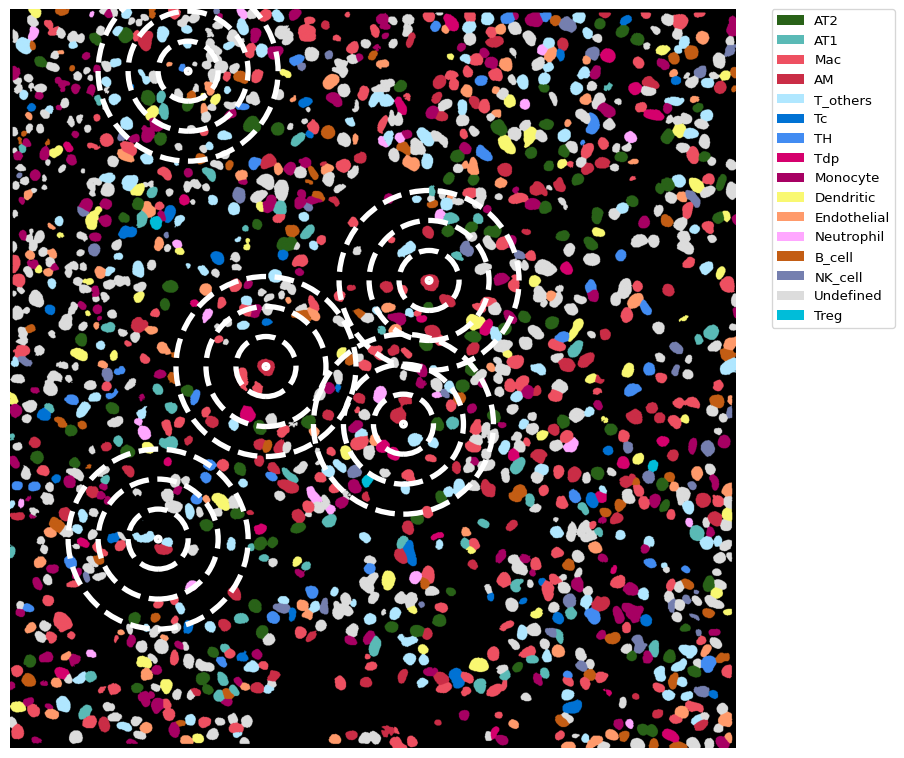

In [ ]:
for sample in samples:
    file_list = [sample]
    file_path = f'./{input_dir}/{sample}-cellspots.csv'
    top_density_centers = find_density_centers(file_path, gene_name, sample,top_n=1,
                                            n_clusters=5, min_distance=120)
    radii = [60, 120, 180]
    analyze_samples(file_list, input_dir, cell_types, colors, top_density_centers, radii)

In [17]:
import os
import pandas as pd

input_dir = 'diaowang_res'
os.makedirs('diaowang-counts',exist_ok=True)

all_counts = None
for fname in os.listdir(input_dir):
    if not fname.endswith('.csv'):
        continue
    df = pd.read_csv(os.path.join(input_dir, fname))
    counts = df.groupby(['diaowang', 'claster']).size().unstack(fill_value=0)
    print(counts)
    counts.to_csv(f'diaowang-counts/{fname}')
    if all_counts is None:
        all_counts = counts
    else:
        all_counts = all_counts.add(counts, fill_value=0)

all_counts = all_counts.fillna(0).astype(int)

claster    AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
diaowang                                                                 
False     180   48   94      53         34           73  235        86   
True        4    1    0       0          3            1    4         3   

claster   NK_cell  Neutrophil  TH  T_others  Tc  Tdp  Undefined  
diaowang                                                         
False          28          12  12        46   8    1        180  
True            1           1   0         2   0    0          9  
claster    AM  AT1  AT2  B_cell  Dendritic  Endothelial  Mac  Monocyte  \
diaowang                                                                 
False     116   46   70      67         56           36  190        61   
True        5    4    2       6          4            6    8         1   

claster   NK_cell  Neutrophil  TH  T_others  Tc  Tdp  Undefined  
diaowang                                                         
False     

In [19]:
import os
import pandas as pd

input_dir = 'diaowang_res'
os.makedirs('niche-diaowang-counts',exist_ok=True)

all_counts = None
for fname in os.listdir(input_dir):
    if not fname.endswith('.csv'):
        continue
    df = pd.read_csv(os.path.join(input_dir, fname))
    counts = df.groupby(['niche', 'diaowang']).size().unstack(fill_value=0)
    print(counts)
    counts.to_csv(f'niche-diaowang-counts/{fname}')
    if all_counts is None:
        all_counts = counts
    else:
        all_counts = all_counts.add(counts, fill_value=0)

all_counts = all_counts.fillna(0).astype(int)

diaowang        False  True 
niche                       
Bystander cell    962     23
High               17      0
High+               5      0
Semi infected     106      6
diaowang        False  True 
niche                       
Bystander cell    785     54
High               13      1
High+              11      0
Semi infected     199      9
diaowang        False  True 
niche                       
Bystander cell   1095     17
High               17      2
High+               9      2
Semi infected     190     10
diaowang        False  True 
niche                       
Bystander cell   1861    105
Semi infected     121      2
diaowang        False  True 
niche                       
Bystander cell    748     20
High               25      1
High+               4      0
Semi infected     416     13
diaowang        False  True 
niche                       
Bystander cell    990     34
High               33      2
High+              23      0
Semi infected     162     10
diaowang      

In [ ]:
import os
import pandas as pd

input_dir = 'diaowang- /diaowang_res_250705'

output_file = 'diaowang_niche_combined_counts.csv'
os.makedirs('diaowang-niche', exist_ok=True)
all_counts = None
for fname in os.listdir(input_dir):
    if not fname.endswith('.csv'):
        continue
    df = pd.read_csv(os.path.join(input_dir, fname))
    counts = df.groupby(['diaowang', 'niche']).size().unstack(fill_value=0)
    counts.to_csv(f'./diaowang-niche/{fname}')
    if all_counts is None:
        all_counts = counts
    else:
        all_counts = all_counts.add(counts, fill_value=0)

all_counts = all_counts.fillna(0).astype(int)
all_counts.to_csv(output_file)

In [ ]:
import os
import pandas as pd

input_dir = 'diaowang- /diaowang_res_250705'

output_file = 'diaowang_niche_combined_counts.csv'
os.makedirs('diaowang-niche', exist_ok=True)
all_counts = None
for fname in os.listdir(input_dir):
    if not fname.endswith('.csv'):
        continue
    df = pd.read_csv(os.path.join(input_dir, fname))
    counts = df.groupby(['diaowang', 'niche']).size().unstack(fill_value=0)
    counts.to_csv(f'./diaowang-niche/{fname}')
    if all_counts is None:
        all_counts = counts
    else:
        all_counts = all_counts.add(counts, fill_value=0)

all_counts = all_counts.fillna(0).astype(int)
all_counts.to_csv(output_file)

In [ ]:
import pandas as pd

df = pd.read_csv('ASFV-20250703/DEGs/LAvsEA/LAvsEA_heatmap.csv')
pivot = df.pivot(index='gene', columns='celltype', values='avg_log2FC')
pivot.to_csv('ASFV-20250703/DEGs/LAvsEA/LAvsEA_heatmap_pivot.csv') 